# Carnd-Vehicle-Detection

###  In this project, the goal is to write a software pipeline to identify vehicles in a video from a front-facing camera on a car. 

### v5: tracking frame length 6, all features, window_width =[64,80,96,128,160,192], y_start_stop_all = [[390,480],[390,600],[390, 500],[400, 530],[400, 550], [400,600]], to target frame 675 to 735 

In [1]:
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
import argparse
import cv2
import os
import glob
import time
import pickle
from sklearn.svm import LinearSVC, SVC
from sklearn.preprocessing import StandardScaler
from skimage.feature import hog
from sklearn.model_selection import train_test_split
from mpl_toolkits.mplot3d import Axes3D

## Load Training Data

8792
8968
Example Images..


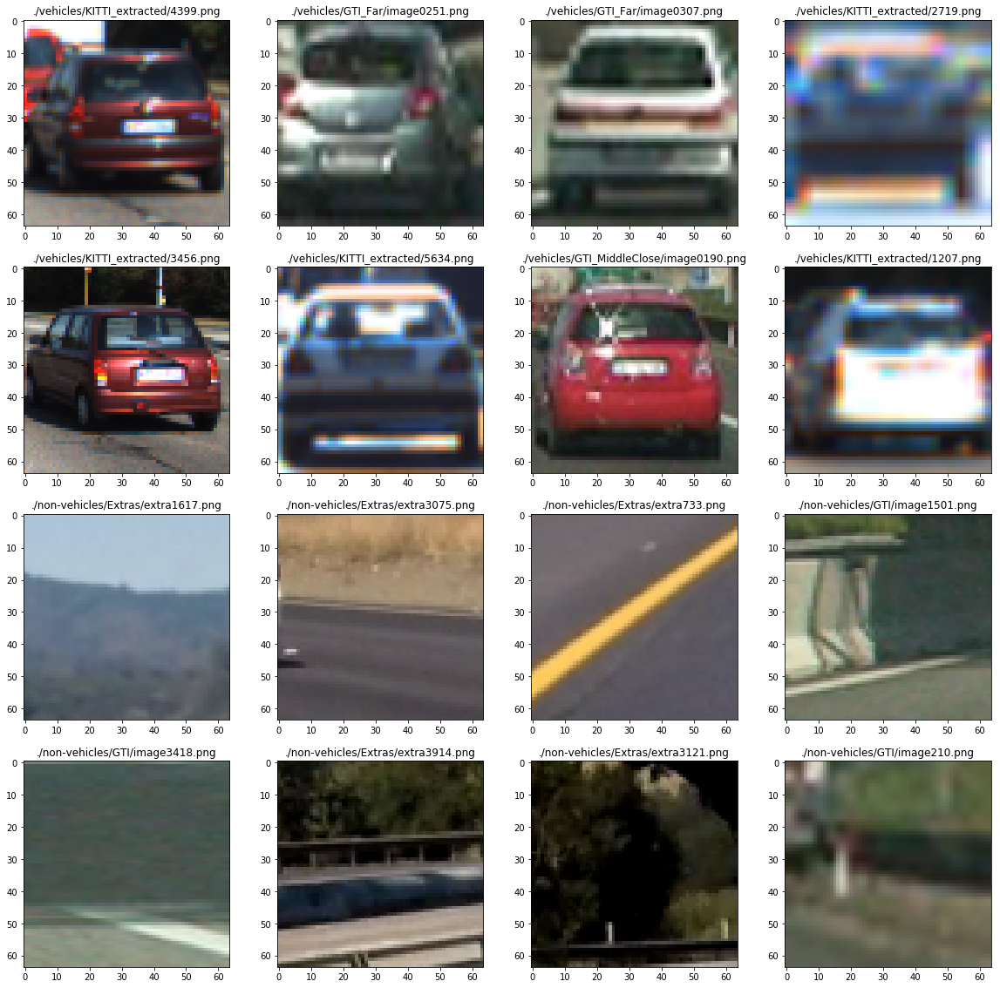

In [2]:
savefigs = True  

import random
# Load Training Data for car, non-car classification
# The file names of the training images
car_files = glob.glob('./vehicles/*/*.png')
noncar_files = glob.glob('./non-vehicles/*/*.png')
# The training images
car_images = []
noncar_images = []
for image in car_files:
     car_images.append(image)
for image in noncar_files:
    noncar_images.append(image)
car_num = len(car_images)
noncar_num = len(noncar_images)
print(car_num)
print(noncar_num)

print("Example Images..")    
# Randomly show example images from cars, and non-cars
example_N_fromEachClass = 8
fig = plt.figure(figsize=(20, 20))
for i in range(0,example_N_fromEachClass):
    # car 
    plt.subplot(4,4,i+1)
    imgfile  = car_images[random.randint (0, car_num -1)]
    img = mpimg.imread(imgfile)
    plt.imshow(img) 
    plt.title(imgfile)
    # non-car
    plt.subplot(4,4,i+ example_N_fromEachClass +1)
    imgfile  = noncar_images[random.randint (0, noncar_num -1)]
    img = mpimg.imread(imgfile)
    plt.imshow(img) 
    plt.title(imgfile)    
plt.show()
if savefigs is True:
    fig.savefig('output_images/example_data.png')

## Feature Extraction
###  Color Histogram,  Color Spatial Binning & Histogram of Oriented Gradients (HOG)

In [3]:
# Lesson Funcctions  -  Codes in this cell are adapted from CarND Class for Vehicle Classifier
# Define a function to convert an image from one color space to another color space
def convert_color(img, conv='RGB2YCrCb'):
    if conv == 'RGB2BGR':
        return cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
    if conv == 'RGB2YCrCb':
        return cv2.cvtColor(img, cv2.COLOR_RGB2YCrCb)
    if conv == 'RGB2LUV':
        return cv2.cvtColor(img, cv2.COLOR_RGB2LUV)
    if conv == 'BGR2LUV':
        return cv2.cvtColor(img, cv2.COLOR_BGR2LUV)
    if conv == 'RGB2YUV':
        return cv2.cvtColor(img, cv2.COLOR_RGB2YUV)
    if conv == 'RGB2HLS':
        return cv2.cvtColor(img, cv2.COLOR_RGB2HLS)

def bin_spatial(img, size=(32, 32)):
    # Convert image to new color space (if specified)
    # Use cv2.resize().ravel() to create the feature vector
    features = cv2.resize(img, size).ravel() 
    # Return the feature vector
    return features

def color_hist(img, nbins=32):
    # Compute the histogram of the color channels separately
    channel1_hist = np.histogram(img[:,:,0], bins=nbins, range=(0, 256))
    channel2_hist = np.histogram(img[:,:,1], bins=nbins, range=(0, 256))
    channel3_hist = np.histogram(img[:,:,2], bins=nbins, range=(0, 256))
    hist_features = np.concatenate((channel1_hist[0], channel2_hist[0], channel3_hist[0]))
    # Return the individual histograms, bin_centers and feature vector
    return hist_features


# Define a function to return HOG features and visualization
def get_hog_features(img, orient, pix_per_cell, cell_per_block, vis=False, feature_vec=True):
    if vis == True:
        features, hog_image = hog(img, orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell),
                                  cells_per_block=(cell_per_block, cell_per_block), transform_sqrt=False, 
                                  visualise=True, feature_vector=False)
        return features, hog_image
    else:      
        features = hog(img, orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell),
                       cells_per_block=(cell_per_block, cell_per_block), transform_sqrt=False, 
                       visualise=False, feature_vector=feature_vec)
        return features  

    
# study the distribution of color values in an image by plotting each pixel in some color space.
# Here's a code snippet to generate 3D plots:
def plot3d(pixels, colors_rgb, axis_labels=list("RGB"), axis_limits=((0, 255), (0, 255), (0, 255))):
    """Plot pixels in 3D."""

    # Create figure and 3D axes
    fig = plt.figure(figsize=(8, 8))
    ax = Axes3D(fig)

    # Set axis limits
    ax.set_xlim(*axis_limits[0])
    ax.set_ylim(*axis_limits[1])
    ax.set_zlim(*axis_limits[2])

    # Set axis labels and sizes
    ax.tick_params(axis='both', which='major', labelsize=14, pad=8)
    ax.set_xlabel(axis_labels[0], fontsize=16, labelpad=16)
    ax.set_ylabel(axis_labels[1], fontsize=16, labelpad=16)
    ax.set_zlabel(axis_labels[2], fontsize=16, labelpad=16)

    # Plot pixel values with colors given in colors_rgb
    ax.scatter(
        pixels[:, :, 0].ravel(),
        pixels[:, :, 1].ravel(),
        pixels[:, :, 2].ravel(),
        c=colors_rgb.reshape((-1, 3)), edgecolors='none')

    return ax  # return Axes3D object for further manipulation

## Test hog features

/home/qliu/anaconda3/lib/python3.6/site-packages/skimage/feature/_hog.py:119: skimage_deprecation: Default value of `block_norm`==`L1` is deprecated and will be changed to `L2-Hys` in v0.15
  'be changed to `L2-Hys` in v0.15', skimage_deprecation)


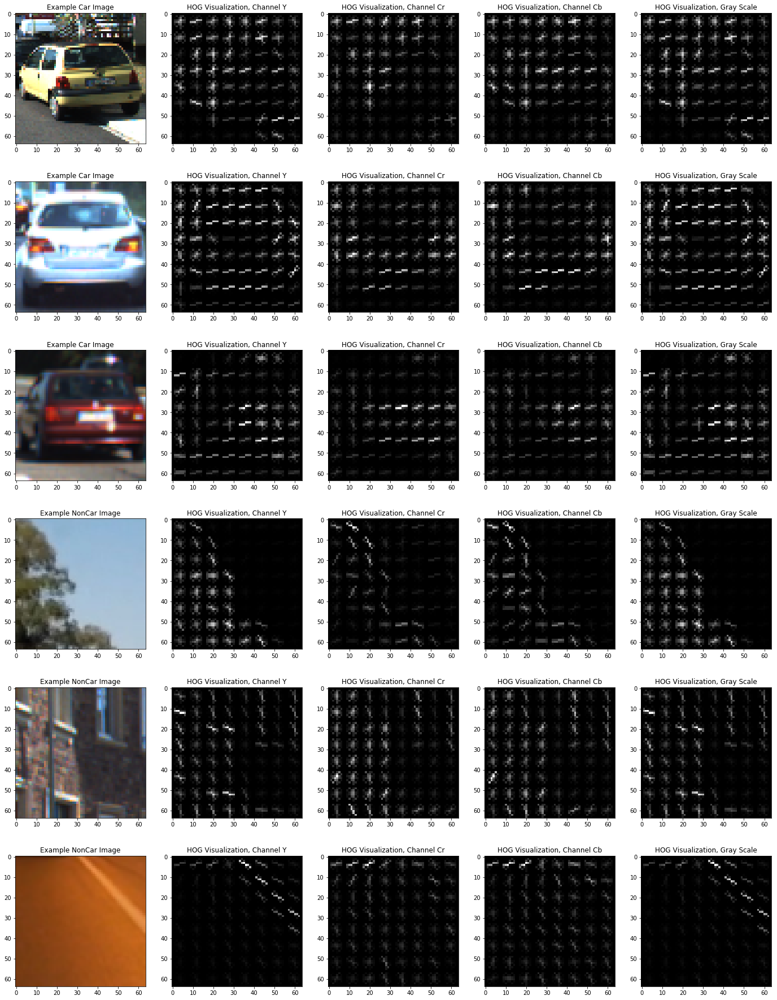

In [4]:
# Test hog features
folder = "./test_images_carNoncar/"
cars=["25.png", "31.png", "53.png"]
noncars  = ["2.png", "3.png", "8.png"]
# color space for hog features
conv ='RGB2YCrCb'
colors =['Y','Cr','Cb']
# Define HOG parameters
orient = 9
pix_per_cell = 8
cell_per_block = 2
# HOG Features for sample cars images
fig = plt.figure(figsize=(24,32))
for i in range(len(cars)): 
    img0 = mpimg.imread(folder+cars[i])
    img = convert_color(img0, conv = conv) 
    plt.subplot(6,5,5*i+1)
    plt.imshow(img0)
    plt.title('Example Car Image')    
    for c in range(3):     
        # Call our function with vis=True to see an image output
        features, hog_image = get_hog_features(img[:,:,c], orient, pix_per_cell, cell_per_block, 
                              vis=True, feature_vec=False)
        plt.subplot(6,5,5*i+1+c+1)
        plt.imshow(hog_image, cmap='gray')
        plt.title('HOG Visualization, Channel '+ colors[c])
    
    # Test gray scale
    features, hog_image = get_hog_features(cv2.cvtColor(img0, cv2.COLOR_RGB2GRAY), orient, pix_per_cell, cell_per_block, 
                          vis=True, feature_vec=False)       
    plt.subplot(6,5,5*i+1+c+1+1)
    plt.imshow(hog_image, cmap='gray')
    plt.title('HOG Visualization, Gray Scale')        
# HOG Features for sample noncars images
for i in range(len(noncars)): 
    img0 = mpimg.imread(folder+noncars[i])
    img = convert_color(img0, conv = conv) 
    plt.subplot(6,5,15+5*i+1)
    plt.imshow(img0)
    plt.title('Example NonCar Image')
    
    for c in range(3):     
        # Call our function with vis=True to see an image output
        features, hog_image = get_hog_features(img[:,:,c], orient, pix_per_cell, cell_per_block, 
                           vis=True, feature_vec=False)       
        plt.subplot(6,5,15+5*i+1+c+1)
        plt.imshow(hog_image, cmap='gray')
        plt.title('HOG Visualization, Channel '+ colors[c])
        
    # Gray scale
    features, hog_image = get_hog_features(cv2.cvtColor(img0, cv2.COLOR_RGB2GRAY), orient, pix_per_cell, cell_per_block, 
                           vis=True, feature_vec=False)     
    plt.subplot(6,5,15+5*i+1+c+1+1)
    plt.imshow(hog_image, cmap='gray')
    plt.title('HOG Visualization, Gray Scale')    
plt.show()   

if savefigs is True:
    fig.savefig('output_images/hog_features.png')   


## Combine Features 

In [5]:
### Codes in this cell are adapted from CarND Class for Vehicle Classifier
def single_img_features(image, color_space='RGB', spatial_size=(32, 32),
                     hist_bins=32, orient=9,
                     pix_per_cell=8, cell_per_block=2, hog_channel=0,
                     spatial_feat=True, hist_feat=True, hog_feat=True):
    # apply color conversion if other than 'BGR' from cv2
    if color_space != 'RGB':
        if color_space == 'HSV':
            feature_image = convert_color(image, conv='RGB2HSV')        
        elif color_space == 'LUV':
            feature_image = convert_color(image, conv='RGB2LUV')
        elif color_space == 'HLS':
            feature_image = convert_color(image, conv='RGB2HLS')
        elif color_space == 'YUV':
            feature_image = convert_color(image, conv='RGB2YUV')
        elif color_space == 'YCrCb':
            feature_image = convert_color(image, conv='RGB2YCrCb')
    else:
        feature_image = np.copy(image)

    file_features = []
    if spatial_feat == True:
        spatial_features = bin_spatial(feature_image, size=spatial_size)
        file_features.append(spatial_features)
    if hist_feat == True:
        # Apply color_hist()
        hist_features = color_hist(feature_image, nbins=hist_bins)
        file_features.append(hist_features)
    if hog_feat == True:
        # Call get_hog_features() with vis=False, feature_vec=True
        if hog_channel == 'ALL':
            hog_features = []
            for channel in range(feature_image.shape[2]):
                hog_features.append(get_hog_features(feature_image[:, :, channel],
                                                     orient, pix_per_cell, cell_per_block,
                                                     vis=False, feature_vec=True))
            hog_features = np.ravel(hog_features)
        else:
            hog_features = get_hog_features(feature_image[:, :, hog_channel], orient,
                                            pix_per_cell, cell_per_block, vis=False, feature_vec=True)
        # Append the new feature vector to the features list
        file_features.append(hog_features)
    return np.concatenate(file_features)

# Define a function to extract features from a list of images
def extract_features(imgs, color_space='RGB', spatial_size=(32, 32),
                        hist_bins=32, orient=9, 
                        pix_per_cell=8, cell_per_block=2, hog_channel=0,
                        spatial_feat=True, hist_feat=True, hog_feat=True):
    # Create a list to append feature vectors to
    features = []
  
    # Iterate through the list of images
    for file in imgs:
        file_features = []   
        # Read in each one by one
        image = mpimg.imread(file)[:,:,:3]
        file_features = single_img_features(image, color_space=color_space, spatial_size = spatial_size,
                            hist_bins=hist_bins, orient=orient,
                            pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, hog_channel=hog_channel,
                            spatial_feat=spatial_feat, hist_feat=hist_feat, hog_feat=hog_feat)
        features.append(file_features)
   
    # Return list of feature vectors
    return features

## Build a Classifier

In [6]:
# Combine and Normalize Features
spatial_feat = True
hist_feat = True
hog_feat = True
# color space 
color_space = 'YCrCb'
# HOG parameters
# HOG channel
hog_channel = 'ALL'
# HOG orientations
orient = 9
# HOG pix_per_cell
pix_per_cell = 8
# HOG cell_per_block
cell_per_block = 2
# color histogram bin number
hist_bins = 16
# Bin spatial size
spatial_size=(16, 16)

# Feature Extraction         
car_features = extract_features(car_files, color_space=color_space, spatial_size=spatial_size, 
                        hist_bins = hist_bins,orient=orient, 
                        pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, hog_channel=hog_channel, 
                        spatial_feat=spatial_feat, hist_feat=hist_feat, hog_feat=hog_feat)
noncar_features = extract_features(noncar_files, color_space=color_space, spatial_size=spatial_size, 
                        hist_bins = hist_bins,orient=orient, 
                        pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, hog_channel=hog_channel, 
                        spatial_feat=spatial_feat, hist_feat=hist_feat, hog_feat=hog_feat)
print(len(car_features))
print(len(noncar_features))

# Create an array stack of feature vectors
X = np.vstack((car_features, noncar_features)).astype(np.float64)                        
# Fit a per-column scaler
X_scaler = StandardScaler().fit(X)
# Apply the scaler to X
scaled_X = X_scaler.transform(X)

# Define the labels vector
y = np.hstack((np.ones(len(car_features)), np.zeros(len(noncar_features))))

# Split up data into randomized training and test sets
rand_state = np.random.randint(0, 100)
X_train, X_test, y_train, y_test = train_test_split(
    scaled_X, y, test_size=0.2, random_state=rand_state)
print('Size of Training Data:', X_train.shape)
print('Size of Test Data:', X_test.shape)

# SVC linear clasifier
svc = LinearSVC() # Use a linear SVC 
# RBF support vector machine classifiers
# svc = SVC(C=100, gamma=0.05)
print('training svc...')
t=time.time()
svc.fit(X_train, y_train) # Train the classifier
t2 = time.time()
print(round(t2-t, 2), 'Seconds to train SVC...')
print('Test Accuracy of SVC = ', round(svc.score(X_test, y_test), 4)) # Check the score of the SVC

/home/qliu/anaconda3/lib/python3.6/site-packages/skimage/feature/_hog.py:119: skimage_deprecation: Default value of `block_norm`==`L1` is deprecated and will be changed to `L2-Hys` in v0.15
  'be changed to `L2-Hys` in v0.15', skimage_deprecation)


8792
8968
Size of Training Data: (14208, 6108)
Size of Test Data: (3552, 6108)
training svc...
11.48 Seconds to train SVC...
Test Accuracy of SVC =  0.9873


## Slide Window Search 

In [7]:
### Codes in this cell are adapted from CarND Class for Vehicle Classifier
# Define a function that takes an image,
# start and stop positions in both x and y, 
# window size (x and y dimensions),  
# and overlap fraction (for both x and y)
def slide_window(img, x_start_stop=[None, None], y_start_stop=[None, None], 
                    xy_window=(64, 64), xy_overlap=(0.5, 0.5)):
    # If x and/or y start/stop positions not defined, set to image size
    if x_start_stop[0] == None:
        x_start_stop[0] = 0
    if x_start_stop[1] == None:
        x_start_stop[1] = img.shape[1]
    if y_start_stop[0] == None:
        y_start_stop[0] = 0
    if y_start_stop[1] == None:
        y_start_stop[1] = img.shape[0]
    # Compute the span of the region to be searched    
    xspan = x_start_stop[1] - x_start_stop[0]
    yspan = y_start_stop[1] - y_start_stop[0]
    # Compute the number of pixels per step in x/y
    nx_pix_per_step = np.int(xy_window[0]*(1 - xy_overlap[0]))
    ny_pix_per_step = np.int(xy_window[1]*(1 - xy_overlap[1]))
    # Compute the number of windows in x/y
    nx_buffer = np.int(xy_window[0]*(xy_overlap[0]))
    ny_buffer = np.int(xy_window[1]*(xy_overlap[1]))
    nx_windows = np.int((xspan-nx_buffer)/nx_pix_per_step) 
    ny_windows = np.int((yspan-ny_buffer)/ny_pix_per_step) 
    # Initialize a list to append window positions to
    window_list = []
    # Loop through finding x and y window positions
    # Note: you could vectorize this step, but in practice
    # you'll be considering windows one by one with your
    # classifier, so looping makes sense
    for ys in range(ny_windows):
        for xs in range(nx_windows):
            # Calculate window position
            startx = xs*nx_pix_per_step + x_start_stop[0]
            endx = startx + xy_window[0]
            starty = ys*ny_pix_per_step + y_start_stop[0]
            endy = starty + xy_window[1]
            # Append window position to list
            window_list.append(((startx, starty), (endx, endy)))
    # Return the list of windows
    return window_list

# Define a function you will pass an image 
# and the list of windows to be searched (output of slide_windows())
def search_windows(img, windows, clf, scaler, color_space='RGB', 
                    spatial_size=(32, 32), hist_bins=32, 
                    hist_range=(0, 256), orient=9, 
                    pix_per_cell=8, cell_per_block=2, 
                    hog_channel=0, spatial_feat=True, 
                    hist_feat=True, hog_feat=True):

    #1) Create an empty list to receive positive detection windows
    on_windows = []
    #2) Iterate over all windows in the list
    for window in windows:
        #3) Extract the test window from original image
        test_img = cv2.resize(img[window[0][1]:window[1][1], window[0][0]:window[1][0]], (64, 64))      
        #4) Extract features for that window using single_img_features()
        features = single_img_features(test_img, color_space=color_space, 
                            spatial_size=spatial_size, hist_bins=hist_bins, 
                            orient=orient, pix_per_cell=pix_per_cell, 
                            cell_per_block=cell_per_block, 
                            hog_channel=hog_channel, spatial_feat=spatial_feat, 
                            hist_feat=hist_feat, hog_feat=hog_feat)
        #5) Scale extracted features to be fed to classifier
        test_features = scaler.transform(np.array(features).reshape(1, -1))
        #6) Predict using your classifier
        prediction = clf.predict(test_features)
        #7) If positive (prediction == 1) then save the window
        if prediction == 1:
            on_windows.append(window)
    #8) Return windows for positive detections
    return on_windows

def draw_boxes(img, bboxes, color=(0, 0, 255), thick=6):
    # Make a copy of the image
    imcopy = np.copy(img)
    # Iterate through the bounding boxes
    for bbox in bboxes:
        # Draw a rectangle given bbox coordinates
        cv2.rectangle(imcopy, bbox[0], bbox[1], color, thick)
    # Return the image copy with boxes drawn
    return imcopy

## Test Slide Window Search

/home/qliu/anaconda3/lib/python3.6/site-packages/skimage/feature/_hog.py:119: skimage_deprecation: Default value of `block_norm`==`L1` is deprecated and will be changed to `L2-Hys` in v0.15
  'be changed to `L2-Hys` in v0.15', skimage_deprecation)


test_images/test1.jpg


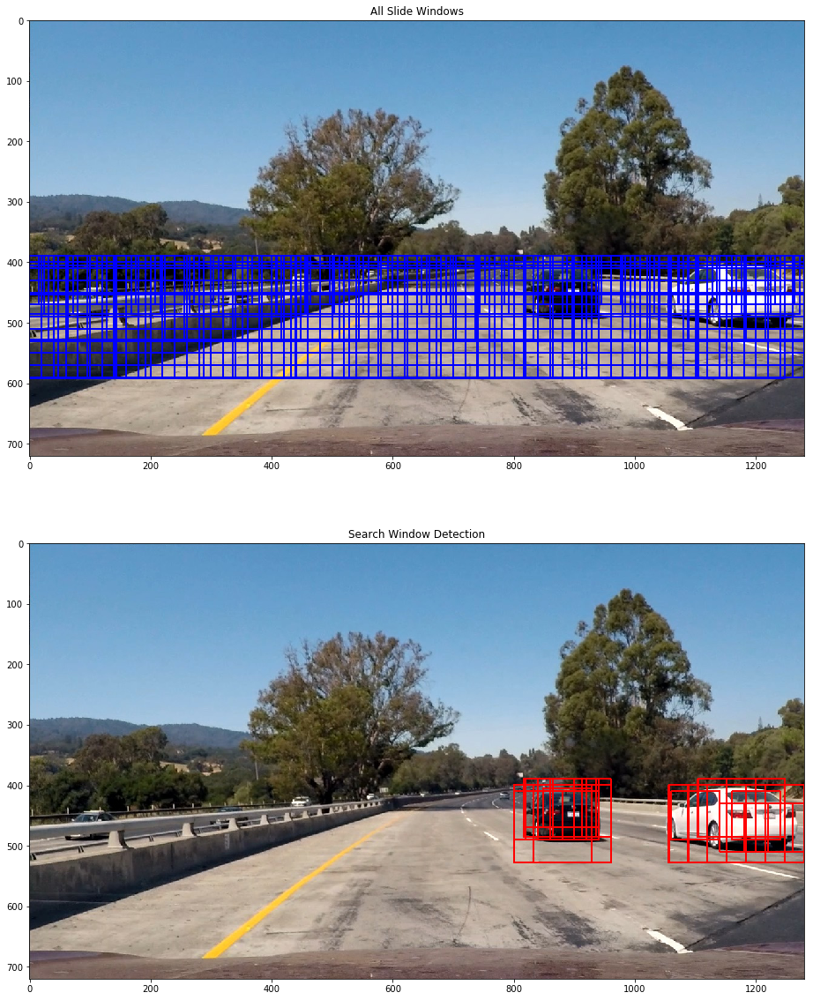

test1.jpg
test_images/test2.jpg


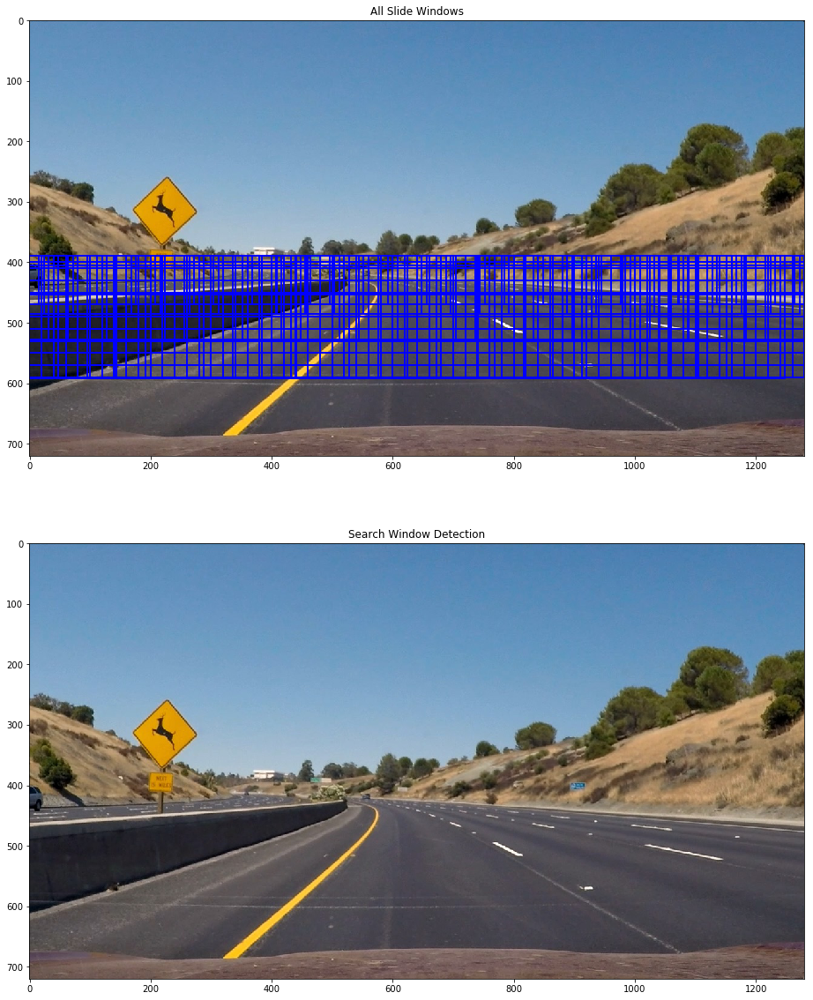

test2.jpg
test_images/test3.jpg


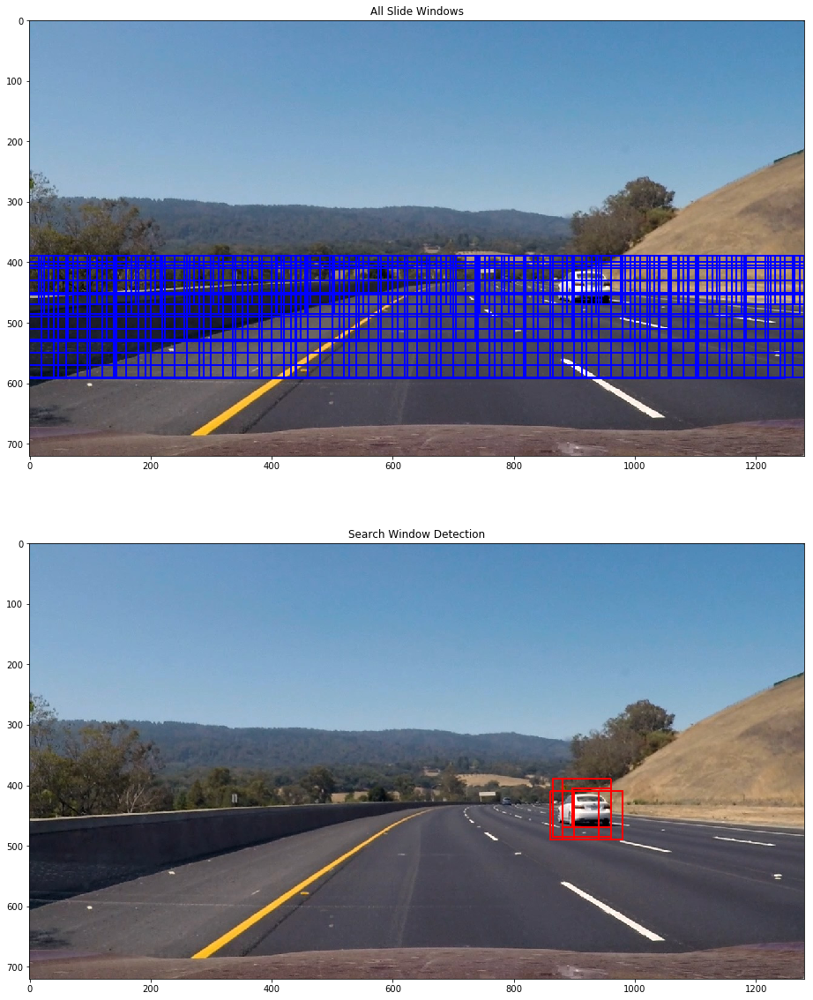

test3.jpg
test_images/test4.jpg


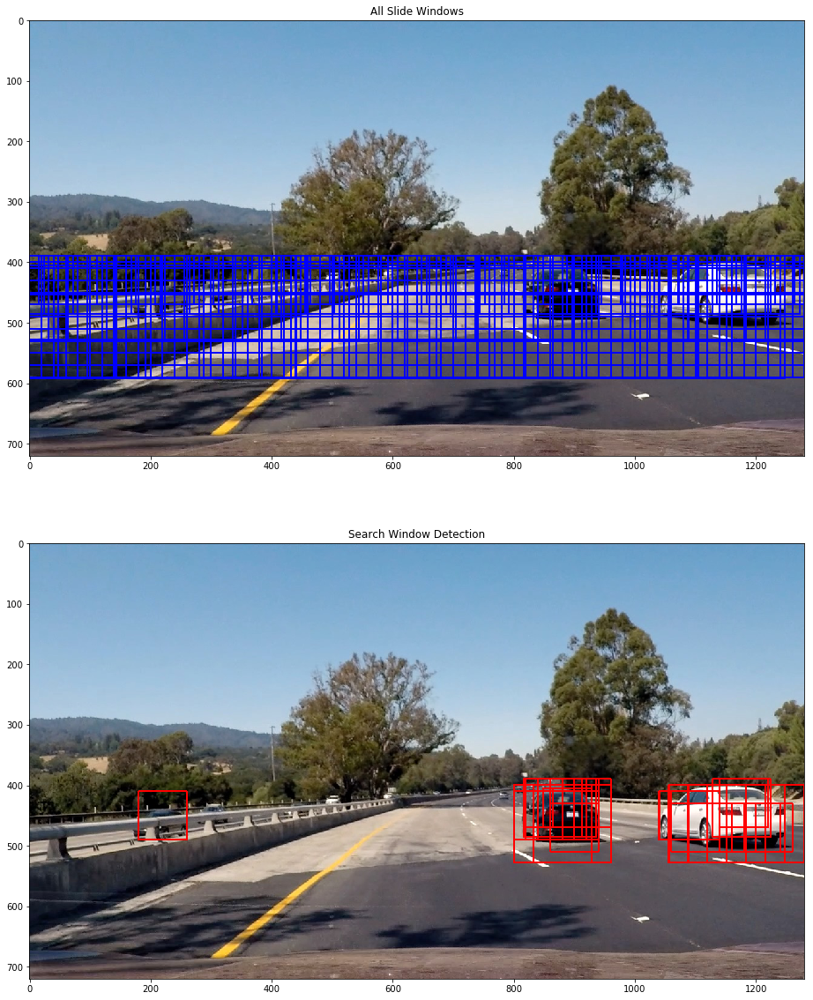

test4.jpg
test_images/test5.jpg


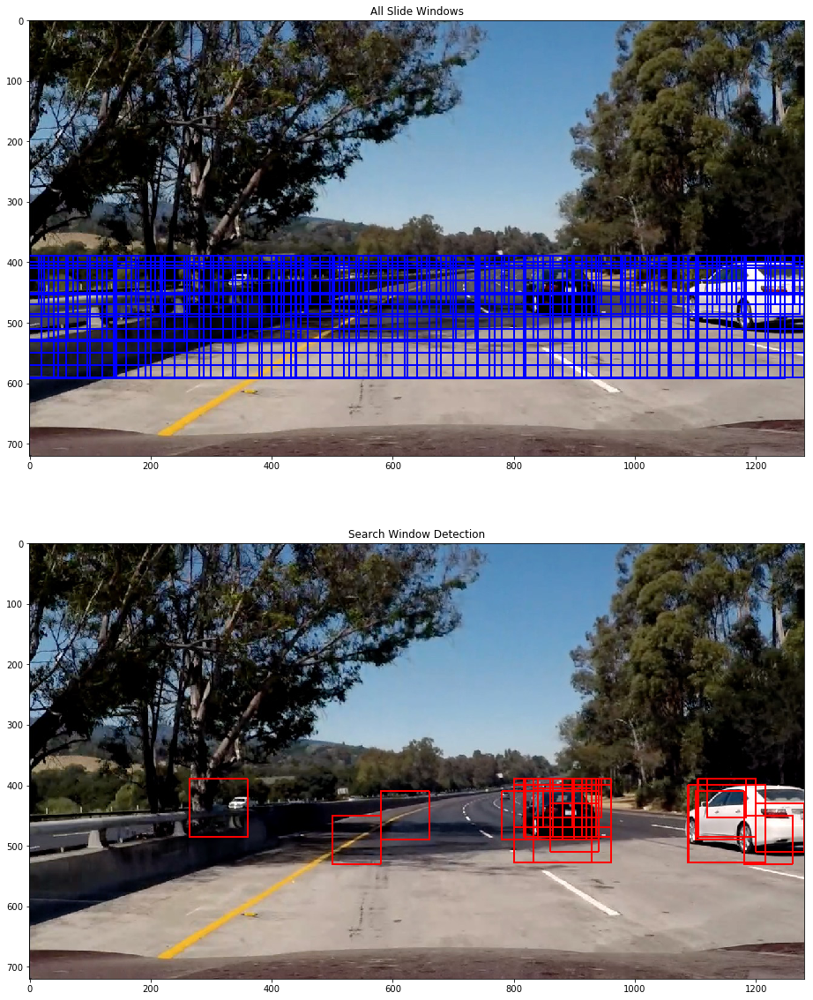

test5.jpg
test_images/test6.jpg


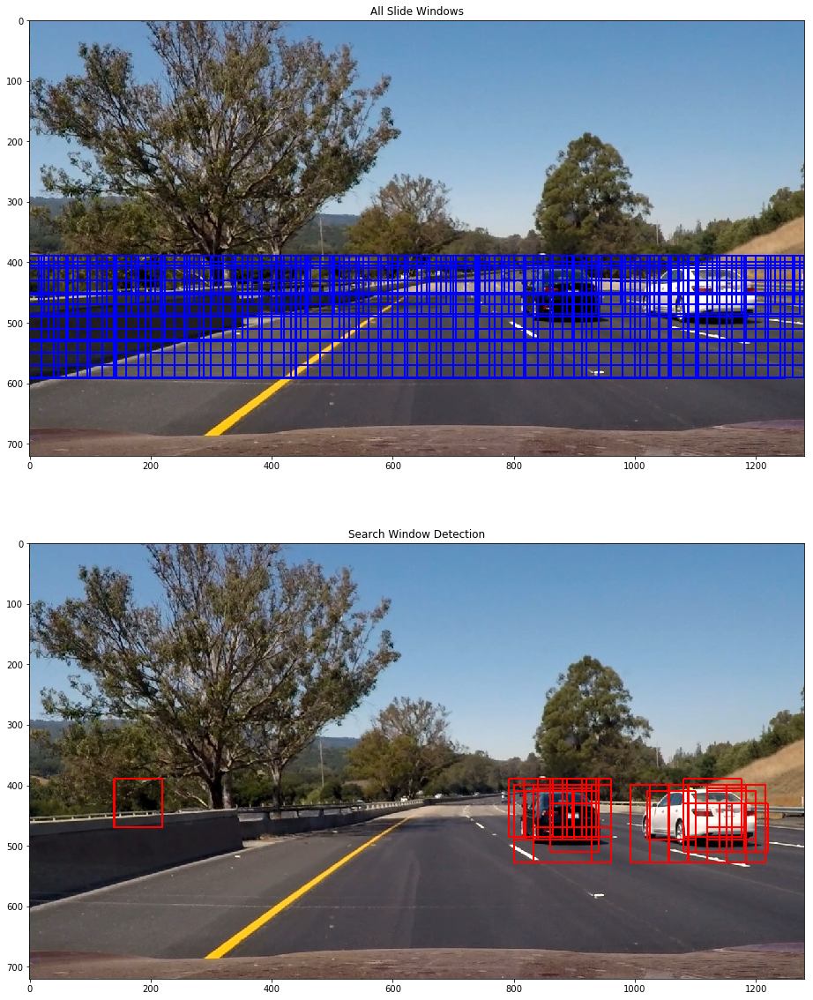

test6.jpg


In [8]:
# Define different window based on how far it is to the camera
window_width =[64,80,96,128,160,192]
y_start_stop_all = [[390,480],[390,600],[390, 500],[400, 530],[400, 550], [400,600]]
x_start_stop=[None, None]
windows =[]
image = mpimg.imread('test_images/test1.jpg')        
for k in range(len(window_width)):
    
    xy_window = (window_width[k],window_width[k])
    y_start_stop = y_start_stop_all[k]
    
    windows += slide_window(image, x_start_stop, y_start_stop,xy_window, xy_overlap=(0.75, 0.75))

for file in glob.glob('test_images/test*.jpg'):
    img = mpimg.imread(file)
    hist_range=(0,256)
    if np.max(img) > 1.05:
        img1 = img.astype(np.float32)/255        
    
    on_windows = search_windows(img1, windows, svc, X_scaler, color_space, spatial_size, hist_bins, 
                        hist_range, orient, pix_per_cell, cell_per_block, hog_channel, 
                        spatial_feat, hist_feat, hog_feat)

    draw_img_1 = draw_boxes(img, windows, color=(0, 0, 255), thick=2)  
    draw_img_2 = draw_boxes(img, on_windows, color=(255, 0, 0), thick=2)  
    
    print(file)
    fig = plt.figure(figsize=(20,20))
    plt.subplot(2,1,1)
    plt.imshow(draw_img_1)
    plt.title('All Slide Windows')
    plt.subplot(2,1,2)
    plt.imshow(draw_img_2)
    plt.title('Search Window Detection')
    plt.show()
    if savefigs is True:
        fname = file.split('/')
        print(fname[1])
        fig.savefig('output_images/test_slide_window_' + fname[1])


## Car Finding with Heat Map

In [9]:
### Codes in this cell are adapted or directly from CarND Class for Vehicle Classifier
# Define a function to draw bounding boxes
# function that adds "heat" to a map for a list of bounding boxes.
def add_heat(heatmap, bbox_list):
    # Iterate through list of bboxes
    for box in bbox_list:
        # Add += 1 for all pixels inside each bbox
        # Assuming each "box" takes the form ((x1, y1), (x2, y2))
        heatmap[box[0][1]:box[1][1], box[0][0]:box[1][0]] += 1
    # Return updated heatmap
    return heatmap

# function to threshold the heatmap.
def apply_threshold(heatmap, threshold):
    # Zero out pixels below the threshold
    heatmap[heatmap <= threshold] = 0
    # Return thresholded map
    return heatmap

#  take labels image and put bounding boxes around the labeled regions
def draw_labeled_bboxes(img, labels):
    # Iterate through all detected cars
    for car_number in range(1, labels[1]+1):
        # Find pixels with each car_number label value
        nonzero = (labels[0] == car_number).nonzero()
        # Identify x and y values of those pixels
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Define a bounding box based on min/max x and y
        bbox = ((np.min(nonzerox), np.min(nonzeroy)), (np.max(nonzerox), np.max(nonzeroy)))
        # Draw the box on the image
        cv2.rectangle(img, bbox[0], bbox[1], (255,0,0), 6)
    # Return the image
    return img

# define function to find  combined boxes with heat map
from scipy.ndimage.measurements import label

def combine_box_with_heatmap(boxes, image, threshold = 5): 
    heat = np.zeros_like(image[:,:,0]).astype(np.float)
    # Add heat to each box in box list
    heat = add_heat(heat,boxes)
    # Apply threshold to help remove false positives
    heat = apply_threshold(heat,threshold)
    # Visualize the heatmap when displaying    
    heatmap = np.clip(heat, 0, 255)
    # Find final boxes from heatmap using label function
    labels = label(heatmap)
    draw_combined_boxes = draw_labeled_bboxes(np.copy(image), labels)
    return labels, heatmap, draw_combined_boxes
    

## Test  Heat Map 

/home/qliu/anaconda3/lib/python3.6/site-packages/skimage/feature/_hog.py:119: skimage_deprecation: Default value of `block_norm`==`L1` is deprecated and will be changed to `L2-Hys` in v0.15
  'be changed to `L2-Hys` in v0.15', skimage_deprecation)


Test image file:  test_images/test1.jpg
Number of car boxes:  50
Number of car(s):  2


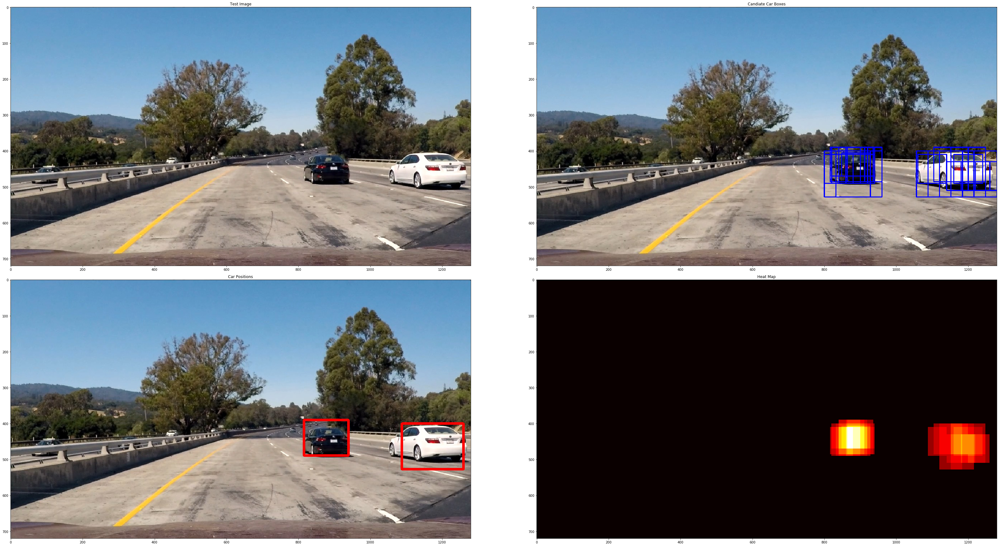

test1.jpg
Test image file:  test_images/test2.jpg
Number of car boxes:  0
Number of car(s):  0


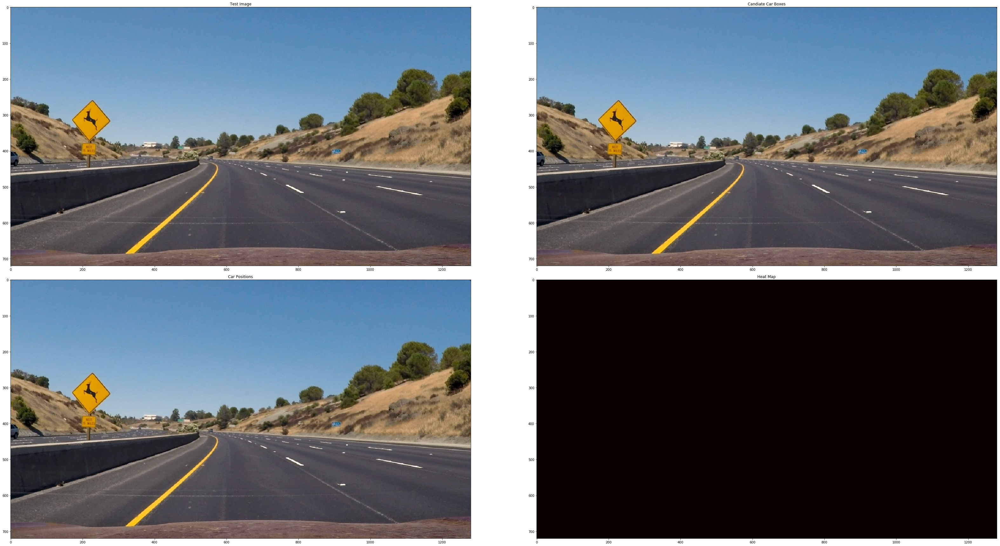

test2.jpg
Test image file:  test_images/test3.jpg
Number of car boxes:  12
Number of car(s):  1


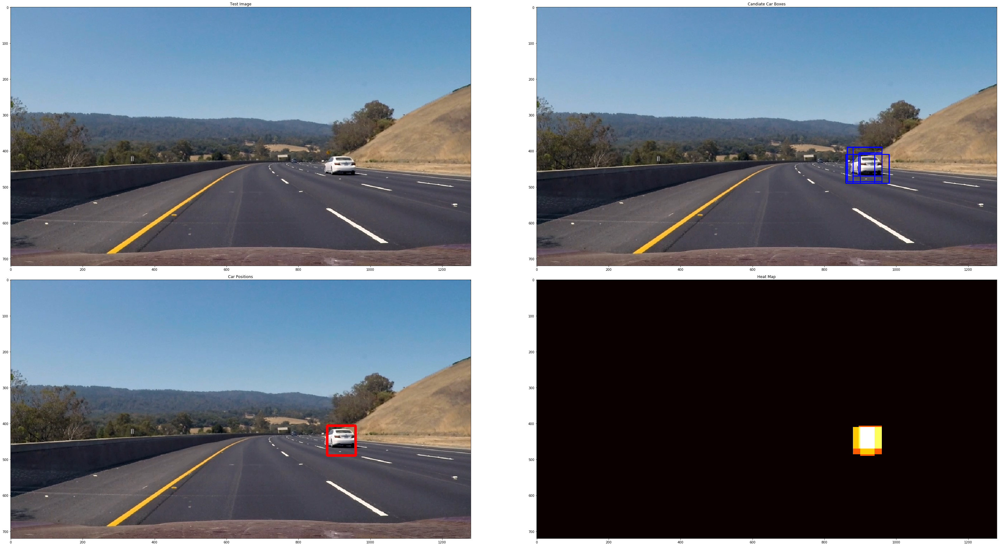

test3.jpg
Test image file:  test_images/test4.jpg
Number of car boxes:  56
Number of car(s):  2


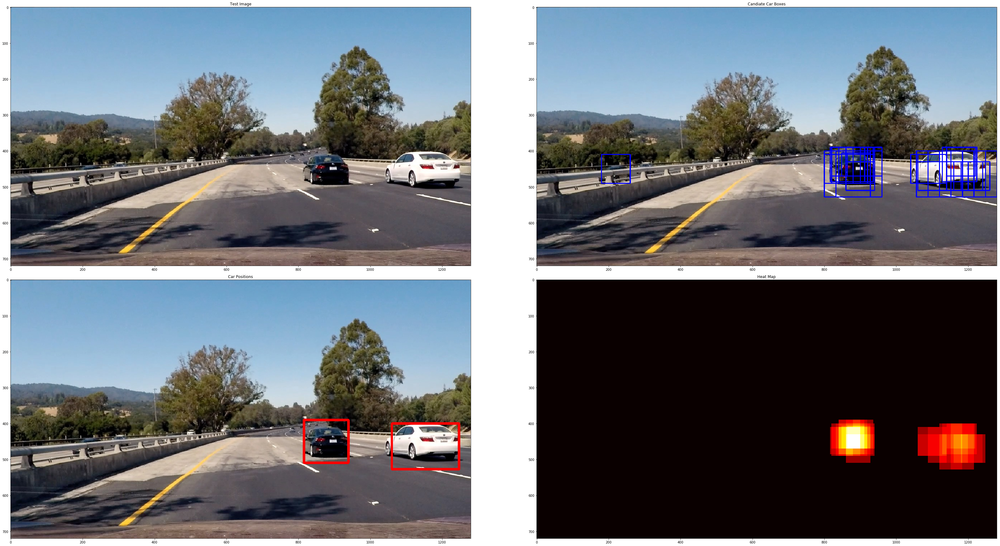

test4.jpg
Test image file:  test_images/test5.jpg
Number of car boxes:  62
Number of car(s):  2


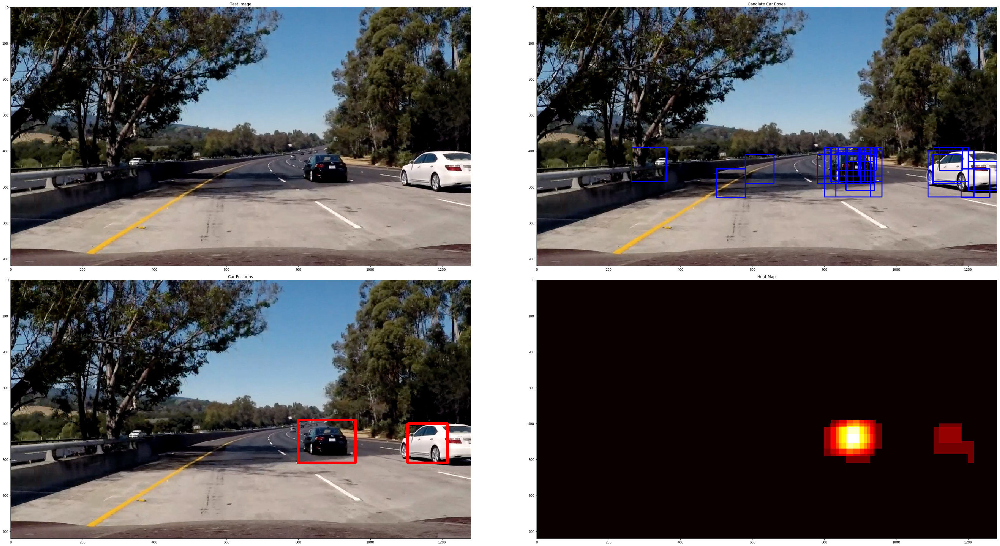

test5.jpg
Test image file:  test_images/test6.jpg
Number of car boxes:  58
Number of car(s):  2


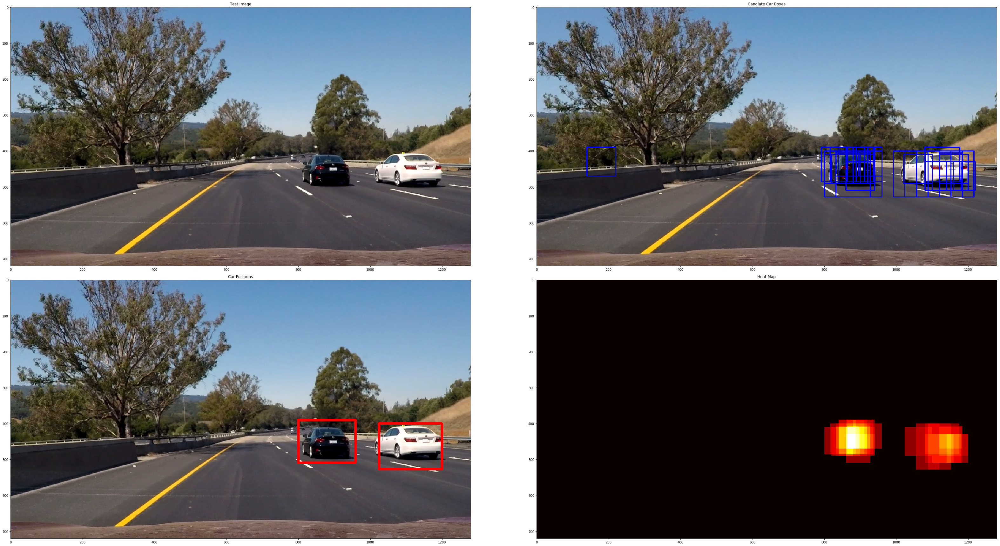

test6.jpg


In [10]:
from scipy.ndimage.measurements import label
x_start_stop=[None, None] 
for k in range(len(window_width)):
    xy_window = (window_width[k],window_width[k])
    y_start_stop = y_start_stop_all[k]
    windows += slide_window(image, x_start_stop, y_start_stop,xy_window, xy_overlap=(0.75, 0.75))
    
for file in glob.glob('test_images/test*.jpg'):
    image = mpimg.imread(file)
    if np.max(img) > 1.05:
        img1 = image.astype(np.float32)/255     
    hist_range=(0,256)
    boxes  = search_windows(img1, windows, svc, X_scaler, color_space, spatial_size, hist_bins, 
                        hist_range, orient, pix_per_cell, cell_per_block, hog_channel, 
                        spatial_feat, hist_feat, hog_feat)       
    draw_multiple_boxes = draw_boxes(image, boxes, color=(0, 0, 255), thick=2)  
    
    
    labels, heatmap, draw_combined_boxes = combine_box_with_heatmap(boxes, image)

    print('Test image file: ', file)
    print('Number of car boxes: ',len(boxes))
    print('Number of car(s): ',labels[1])
    
    fig=plt.figure(figsize=(48, 24))            
    plt.subplot(221)
    plt.imshow(image)
    plt.title('Test Image')    
    plt.subplot(222)
    plt.imshow(draw_multiple_boxes)
    plt.title('Candiate Car Boxes')
    plt.subplot(223)
    plt.imshow(draw_combined_boxes)
    plt.title('Car Positions')
    plt.subplot(224)
    plt.imshow(heatmap, cmap='hot')
    plt.title('Heat Map')
    fig.tight_layout()
    plt.show()
    if savefigs is True:
        fname = file.split('/')
        print(fname[1])
        fig.savefig('output_images/test_heat_map_' + fname[1])

## Video Implementation 

In [11]:
# Tracking boxes in continuous frames
## use deque to keep tracking of the heat map, a list-like container with fast appends and pops on either end
from collections import deque
# initialization of the container
heat_list = deque(maxlen =6)
test_project_video=  False 
if savefigs is True:
    frame_list = deque(maxlen =1300)
def vehicle_detection_pipeline(image, video = True):     
    
    if np.max(image) > 1.05:
        img1 = image.astype(np.float32)/255     
   
    hist_range=(0,256)
    # Search boxed for candidate 
    boxes  = search_windows(img1, windows, svc, X_scaler, color_space, spatial_size, hist_bins, 
                        hist_range, orient, pix_per_cell, cell_per_block, hog_channel, 
                        spatial_feat, hist_feat, hog_feat)       
    
    # Add heat to each box in box list
    heat1 = np.zeros_like(image[:,:,0]).astype(np.float)
    heat1 = add_heat(heat1,boxes)
    heatmap1 = np.clip(heat1, 0, 255)
    
        
    heat = heat1      
    threshold = 5
    heat_list.append(heat1) 
    if video is True:  
        if len(heat_list) >=6:
            heat = np.sum(np.array(heat_list), axis=0)   
            threshold = 10
        else:
            if len(heat_list) >=4:
                heat = np.sum(np.array(heat_list), axis=0)   
                threshold =  8         
            else:
                if len(heat_list) >=2:
                    heat = np.sum(np.array(heat_list), axis=0)   
                    threshold =  6              
                else:
                    threshold = 5
           
        
    heat_thresholded = apply_threshold(heat,threshold)
    heatmap = np.clip(heat_thresholded, 0, 255)
          
    # Find final boxes from heatmap using label function
    labels = label(heatmap)   
    draw_combined_boxes = draw_labeled_bboxes(np.copy(image), labels)  
    
    if savefigs is True:
        frame_list.append(np.copy(threshold))
        print(len(heat_list))
        cnt = len(frame_list)
        print(cnt)
        
        if test_project_video is True : 
            mpimg.imsave('test_frames_v5/frame_'+ str(cnt).strip() +'_orig.jpg', image, format='jpg')
            mpimg.imsave('test_frames_v5/frame_'+str(cnt).strip()+'_heat.jpg', heatmap1, format='jpg')
            mpimg.imsave('test_frames_v5/frame_'+str(cnt).strip()+'_heatmap.jpg', heatmap, format='jpg')
            mpimg.imsave('test_frames_v5/frame_'+str(cnt).strip()+'_boxes.jpg', draw_combined_boxes, format='jpg')

        else: 
            mpimg.imsave('test_frames_testvideo_v5/frame_'+ str(cnt).strip() +'_orig.jpg', image, format='jpg')
            mpimg.imsave('test_frames_testvideo_v5/frame_'+str(cnt).strip()+'_heat.jpg', heatmap1, format='jpg')
            mpimg.imsave('test_frames_testvideo_v5/frame_'+str(cnt).strip()+'_heatmap.jpg', heatmap, format='jpg')
            mpimg.imsave('test_frames_testvideo_v5/frame_'+str(cnt).strip()+'_boxes.jpg', draw_combined_boxes, format='jpg')       

    return draw_combined_boxes

/home/qliu/anaconda3/lib/python3.6/site-packages/skimage/feature/_hog.py:119: skimage_deprecation: Default value of `block_norm`==`L1` is deprecated and will be changed to `L2-Hys` in v0.15
  'be changed to `L2-Hys` in v0.15', skimage_deprecation)


1
1


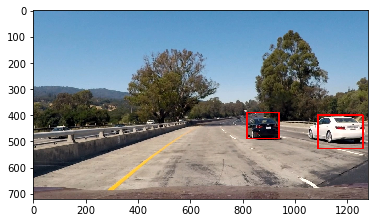

2
2


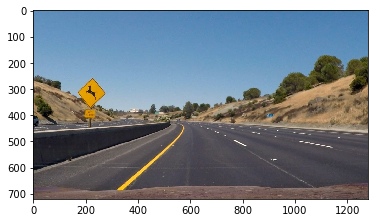

3
3


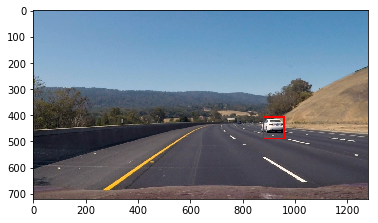

4
4


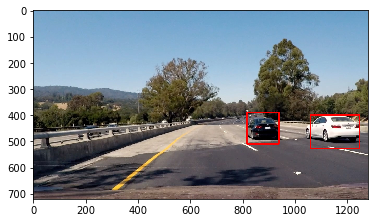

5
5


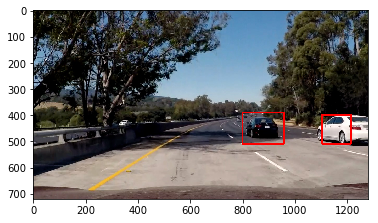

6
6


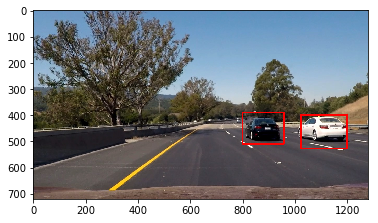

In [12]:
## Test the pipeline with example images
# initialization of the container
heat_list = deque(maxlen =6)
if savefigs is True:
    frame_list = deque(maxlen =40)   
for file in glob.glob('test_images/test*.jpg'):
    image = mpimg.imread(file)
    result = vehicle_detection_pipeline(image, video = False)
    fig = plt.figure()
    plt.imshow(result)
    plt.show()

In [13]:
import imageio
imageio.plugins.ffmpeg.download()
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [ ]:
# initialization of the container
heat_list = deque(maxlen =6)
test_project_vide0 = False 
if savefigs is True:
    frame_list = deque(maxlen =40)        
clip_output = 'test_video_output_v5.mp4'
clip1 = VideoFileClip("test_video.mp4") # .subclip(1, 2)
cnt=0
processor = clip1.fl_image(vehicle_detection_pipeline) #NOTE: this function expects color images!!
%time processor.write_videofile(clip_output, audio=False)

1
1
[MoviePy] >>>> Building video test_video_output_v5.mp4
[MoviePy] Writing video test_video_output_v5.mp4


  0%|          | 0/39 [00:00<?, ?it/s]

2
2


  3%|▎         | 1/39 [00:04<02:52,  4.54s/it]

3
3


  5%|▌         | 2/39 [00:09<02:47,  4.52s/it]

4
4


  8%|▊         | 3/39 [00:13<02:42,  4.51s/it]

5
5


 10%|█         | 4/39 [00:17<02:36,  4.48s/it]

6
6


 13%|█▎        | 5/39 [00:22<02:30,  4.44s/it]

6
7


 15%|█▌        | 6/39 [00:26<02:27,  4.46s/it]

6
8


 18%|█▊        | 7/39 [00:31<02:22,  4.46s/it]

6
9


 21%|██        | 8/39 [00:35<02:19,  4.49s/it]

6
10


 23%|██▎       | 9/39 [00:40<02:14,  4.49s/it]

6
11


 26%|██▌       | 10/39 [00:44<02:10,  4.50s/it]

6
12


 28%|██▊       | 11/39 [00:49<02:06,  4.51s/it]

6
13


 31%|███       | 12/39 [00:53<02:02,  4.53s/it]

6
14


 33%|███▎      | 13/39 [00:58<01:58,  4.54s/it]

6
15


 36%|███▌      | 14/39 [01:02<01:53,  4.53s/it]

6
16


 38%|███▊      | 15/39 [01:07<01:48,  4.51s/it]

6
17


 41%|████      | 16/39 [01:11<01:43,  4.51s/it]

6
18


 44%|████▎     | 17/39 [01:16<01:39,  4.50s/it]

6
19


 46%|████▌     | 18/39 [01:21<01:34,  4.52s/it]

6
20


 49%|████▊     | 19/39 [01:25<01:30,  4.52s/it]

6
21


 51%|█████▏    | 20/39 [01:30<01:25,  4.51s/it]

6
22


 54%|█████▍    | 21/39 [01:34<01:21,  4.50s/it]

6
23


 56%|█████▋    | 22/39 [01:38<01:16,  4.49s/it]

6
24


 59%|█████▉    | 23/39 [01:43<01:11,  4.48s/it]

6
25


 62%|██████▏   | 24/39 [01:47<01:07,  4.49s/it]

6
26


 64%|██████▍   | 25/39 [01:52<01:03,  4.51s/it]

6
27


 67%|██████▋   | 26/39 [01:57<00:59,  4.57s/it]

6
28


 69%|██████▉   | 27/39 [02:01<00:55,  4.59s/it]

6
29


 72%|███████▏  | 28/39 [02:06<00:51,  4.64s/it]

6
30


 74%|███████▍  | 29/39 [02:11<00:46,  4.61s/it]

6
31


 77%|███████▋  | 30/39 [02:15<00:41,  4.60s/it]

6
32


 79%|███████▉  | 31/39 [02:20<00:36,  4.59s/it]

6
33


 82%|████████▏ | 32/39 [02:24<00:32,  4.59s/it]

6
34


 85%|████████▍ | 33/39 [02:29<00:27,  4.60s/it]

6
35


 87%|████████▋ | 34/39 [02:34<00:22,  4.60s/it]

6
36


 90%|████████▉ | 35/39 [02:38<00:18,  4.60s/it]

6
37


 92%|█████████▏| 36/39 [02:43<00:13,  4.60s/it]

6
38


 95%|█████████▍| 37/39 [02:47<00:09,  4.61s/it]

6
39


 97%|█████████▋| 38/39 [02:52<00:04,  4.62s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_video_output_v5.mp4 

CPU times: user 8min 24s, sys: 3.06 s, total: 8min 27s
Wall time: 2min 53s


In [ ]:
# initialization of the container
test_project_video = True 
heat_list = deque(maxlen =6)
if savefigs is True:
    frame_list = deque(maxlen =1300)    
clip_output = 'project_video_output_v5.mp4'
clip1 = VideoFileClip("project_video.mp4") #.subclip(1, 5)
cnt=0
processor = clip1.fl_image(vehicle_detection_pipeline) #NOTE: this function expects color images!!
%time processor.write_videofile(clip_output, audio=False)

1
1
[MoviePy] >>>> Building video project_video_output_v5.mp4
[MoviePy] Writing video project_video_output_v5.mp4


  0%|          | 0/1261 [00:00<?, ?it/s]

2
2


  0%|          | 1/1261 [00:04<1:36:22,  4.59s/it]

3
3


  0%|          | 2/1261 [00:09<1:36:26,  4.60s/it]

4
4


  0%|          | 3/1261 [00:13<1:35:34,  4.56s/it]

5
5


  0%|          | 4/1261 [00:18<1:34:47,  4.52s/it]

6
6


  0%|          | 5/1261 [00:22<1:35:04,  4.54s/it]

6
7


  0%|          | 6/1261 [00:27<1:34:53,  4.54s/it]

6
8


  1%|          | 7/1261 [00:31<1:34:29,  4.52s/it]

6
9


  1%|          | 8/1261 [00:36<1:34:18,  4.52s/it]

6
10


  1%|          | 9/1261 [00:40<1:33:55,  4.50s/it]

6
11


  1%|          | 10/1261 [00:45<1:33:31,  4.49s/it]

6
12


  1%|          | 11/1261 [00:49<1:33:37,  4.49s/it]

6
13


  1%|          | 12/1261 [00:54<1:33:23,  4.49s/it]

6
14


  1%|          | 13/1261 [00:58<1:33:19,  4.49s/it]

6
15


  1%|          | 14/1261 [01:03<1:33:06,  4.48s/it]

6
16


  1%|          | 15/1261 [01:07<1:31:48,  4.42s/it]

6
17


  1%|▏         | 16/1261 [01:11<1:32:08,  4.44s/it]

6
18


  1%|▏         | 17/1261 [01:16<1:32:01,  4.44s/it]

6
19


  1%|▏         | 18/1261 [01:20<1:32:43,  4.48s/it]

6
20


  2%|▏         | 19/1261 [01:25<1:32:54,  4.49s/it]

6
21


  2%|▏         | 20/1261 [01:29<1:33:12,  4.51s/it]

6
22


  2%|▏         | 21/1261 [01:34<1:33:24,  4.52s/it]

6
23


  2%|▏         | 22/1261 [01:38<1:33:32,  4.53s/it]

6
24


  2%|▏         | 23/1261 [01:43<1:33:47,  4.55s/it]

6
25


  2%|▏         | 24/1261 [01:48<1:33:53,  4.55s/it]

6
26


  2%|▏         | 25/1261 [01:52<1:34:02,  4.57s/it]

6
27


  2%|▏         | 26/1261 [01:57<1:34:38,  4.60s/it]

6
28


  2%|▏         | 27/1261 [02:01<1:34:10,  4.58s/it]

6
29


  2%|▏         | 28/1261 [02:06<1:33:55,  4.57s/it]

6
30


  2%|▏         | 29/1261 [02:11<1:33:37,  4.56s/it]

6
31


  2%|▏         | 30/1261 [02:15<1:33:14,  4.54s/it]

6
32


  2%|▏         | 31/1261 [02:20<1:32:38,  4.52s/it]

6
33


  3%|▎         | 32/1261 [02:24<1:32:09,  4.50s/it]

6
34


  3%|▎         | 33/1261 [02:28<1:31:41,  4.48s/it]

6
35


  3%|▎         | 34/1261 [02:33<1:31:23,  4.47s/it]

6
36


  3%|▎         | 35/1261 [02:37<1:31:12,  4.46s/it]

6
37


  3%|▎         | 36/1261 [02:42<1:31:15,  4.47s/it]

6
38


  3%|▎         | 37/1261 [02:46<1:31:22,  4.48s/it]

6
39


  3%|▎         | 38/1261 [02:51<1:30:38,  4.45s/it]

6
40


  3%|▎         | 39/1261 [02:55<1:30:38,  4.45s/it]

6
41


  3%|▎         | 40/1261 [03:00<1:31:00,  4.47s/it]

6
42


  3%|▎         | 41/1261 [03:04<1:31:06,  4.48s/it]

6
43


  3%|▎         | 42/1261 [03:09<1:31:07,  4.49s/it]

6
44


  3%|▎         | 43/1261 [03:13<1:31:02,  4.48s/it]

6
45


  3%|▎         | 44/1261 [03:18<1:30:54,  4.48s/it]

6
46


  4%|▎         | 45/1261 [03:22<1:31:12,  4.50s/it]

6
47


  4%|▎         | 46/1261 [03:27<1:32:47,  4.58s/it]

6
48


  4%|▎         | 47/1261 [03:31<1:32:20,  4.56s/it]

6
49


  4%|▍         | 48/1261 [03:36<1:32:04,  4.55s/it]

6
50


  4%|▍         | 49/1261 [03:41<1:31:57,  4.55s/it]

6
51


  4%|▍         | 50/1261 [03:45<1:31:58,  4.56s/it]

6
52


  4%|▍         | 51/1261 [03:49<1:31:06,  4.52s/it]

6
53


  4%|▍         | 52/1261 [03:54<1:31:42,  4.55s/it]

6
54


  4%|▍         | 53/1261 [03:59<1:33:11,  4.63s/it]

6
55


  4%|▍         | 54/1261 [04:03<1:32:30,  4.60s/it]

6
56


  4%|▍         | 55/1261 [04:08<1:31:24,  4.55s/it]

6
57


  4%|▍         | 56/1261 [04:12<1:30:23,  4.50s/it]

6
58


  5%|▍         | 57/1261 [04:17<1:30:03,  4.49s/it]

6
59


  5%|▍         | 58/1261 [04:21<1:30:04,  4.49s/it]

6
60


  5%|▍         | 59/1261 [04:26<1:29:42,  4.48s/it]

6
61


  5%|▍         | 60/1261 [04:30<1:29:44,  4.48s/it]

6
62


  5%|▍         | 61/1261 [04:35<1:29:49,  4.49s/it]

6
63


  5%|▍         | 62/1261 [04:39<1:29:37,  4.48s/it]

6
64


  5%|▍         | 63/1261 [04:44<1:29:48,  4.50s/it]

6
65


  5%|▌         | 64/1261 [04:48<1:28:19,  4.43s/it]

6
66


  5%|▌         | 65/1261 [04:52<1:28:04,  4.42s/it]

6
67


  5%|▌         | 66/1261 [04:57<1:28:09,  4.43s/it]

6
68


  5%|▌         | 67/1261 [05:01<1:27:51,  4.41s/it]

6
69


  5%|▌         | 68/1261 [05:06<1:28:00,  4.43s/it]

6
70


  5%|▌         | 69/1261 [05:10<1:28:13,  4.44s/it]

6
71


  6%|▌         | 70/1261 [05:15<1:28:42,  4.47s/it]

6
72


  6%|▌         | 71/1261 [05:19<1:29:10,  4.50s/it]

6
73


  6%|▌         | 72/1261 [05:24<1:28:25,  4.46s/it]

6
74


  6%|▌         | 73/1261 [05:28<1:28:33,  4.47s/it]

6
75


  6%|▌         | 74/1261 [05:33<1:28:45,  4.49s/it]

6
76


  6%|▌         | 75/1261 [05:37<1:28:42,  4.49s/it]

6
77


  6%|▌         | 76/1261 [05:41<1:28:05,  4.46s/it]

6
78


  6%|▌         | 77/1261 [05:46<1:28:24,  4.48s/it]

6
79


  6%|▌         | 78/1261 [05:51<1:28:29,  4.49s/it]

6
80


  6%|▋         | 79/1261 [05:55<1:28:22,  4.49s/it]

6
81


  6%|▋         | 80/1261 [06:00<1:28:32,  4.50s/it]

6
82


  6%|▋         | 81/1261 [06:04<1:27:49,  4.47s/it]

6
83


  7%|▋         | 82/1261 [06:08<1:28:11,  4.49s/it]

6
84


  7%|▋         | 83/1261 [06:13<1:28:27,  4.51s/it]

6
85


  7%|▋         | 84/1261 [06:18<1:28:52,  4.53s/it]

6
86


  7%|▋         | 85/1261 [06:22<1:29:01,  4.54s/it]

6
87


  7%|▋         | 86/1261 [06:27<1:28:52,  4.54s/it]

6
88


  7%|▋         | 87/1261 [06:31<1:29:01,  4.55s/it]

6
89


  7%|▋         | 88/1261 [06:36<1:29:01,  4.55s/it]

6
90


  7%|▋         | 89/1261 [06:40<1:29:03,  4.56s/it]

6
91


  7%|▋         | 90/1261 [06:45<1:28:25,  4.53s/it]

6
92


  7%|▋         | 91/1261 [06:49<1:27:23,  4.48s/it]

6
93


  7%|▋         | 92/1261 [06:54<1:26:56,  4.46s/it]

6
94


  7%|▋         | 93/1261 [06:58<1:26:42,  4.45s/it]

6
95


  7%|▋         | 94/1261 [07:03<1:26:36,  4.45s/it]

6
96


  8%|▊         | 95/1261 [07:07<1:26:40,  4.46s/it]

6
97


  8%|▊         | 96/1261 [07:11<1:26:15,  4.44s/it]

6
98


  8%|▊         | 97/1261 [07:16<1:25:57,  4.43s/it]

6
99


  8%|▊         | 98/1261 [07:20<1:26:15,  4.45s/it]

6
100


  8%|▊         | 99/1261 [07:25<1:26:40,  4.48s/it]

6
101


  8%|▊         | 100/1261 [07:29<1:26:54,  4.49s/it]

6
102


  8%|▊         | 101/1261 [07:34<1:27:14,  4.51s/it]

6
103


  8%|▊         | 102/1261 [07:38<1:27:22,  4.52s/it]

6
104


  8%|▊         | 103/1261 [07:43<1:27:18,  4.52s/it]

6
105


  8%|▊         | 104/1261 [07:47<1:26:50,  4.50s/it]

6
106


  8%|▊         | 105/1261 [07:52<1:26:13,  4.48s/it]

6
107


  8%|▊         | 106/1261 [07:56<1:26:24,  4.49s/it]

6
108


  8%|▊         | 107/1261 [08:01<1:25:57,  4.47s/it]

6
109


  9%|▊         | 108/1261 [08:05<1:25:57,  4.47s/it]

6
110


  9%|▊         | 109/1261 [08:10<1:26:03,  4.48s/it]

6
111


  9%|▊         | 110/1261 [08:14<1:25:58,  4.48s/it]

6
112


  9%|▉         | 111/1261 [08:19<1:26:06,  4.49s/it]

6
113


  9%|▉         | 112/1261 [08:23<1:25:57,  4.49s/it]

6
114


  9%|▉         | 113/1261 [08:28<1:25:16,  4.46s/it]

6
115


  9%|▉         | 114/1261 [08:32<1:24:56,  4.44s/it]

6
116


  9%|▉         | 115/1261 [08:37<1:25:23,  4.47s/it]

6
117


  9%|▉         | 116/1261 [08:41<1:25:34,  4.48s/it]

6
118


  9%|▉         | 117/1261 [08:46<1:24:58,  4.46s/it]

6
119


  9%|▉         | 118/1261 [08:50<1:25:02,  4.46s/it]

6
120


  9%|▉         | 119/1261 [08:55<1:25:08,  4.47s/it]

6
121


 10%|▉         | 120/1261 [08:59<1:25:25,  4.49s/it]

6
122


 10%|▉         | 121/1261 [09:04<1:25:23,  4.49s/it]

6
123


 10%|▉         | 122/1261 [09:08<1:25:26,  4.50s/it]

6
124


 10%|▉         | 123/1261 [09:12<1:23:29,  4.40s/it]

6
125


 10%|▉         | 124/1261 [09:17<1:23:23,  4.40s/it]

6
126


 10%|▉         | 125/1261 [09:21<1:23:53,  4.43s/it]

6
127


 10%|▉         | 126/1261 [09:26<1:24:20,  4.46s/it]

6
128


 10%|█         | 127/1261 [09:30<1:24:23,  4.47s/it]

6
129


 10%|█         | 128/1261 [09:35<1:24:44,  4.49s/it]

6
130


 10%|█         | 129/1261 [09:39<1:24:55,  4.50s/it]

6
131


 10%|█         | 130/1261 [09:44<1:24:10,  4.47s/it]

6
132


 10%|█         | 131/1261 [09:48<1:24:00,  4.46s/it]

6
133


 10%|█         | 132/1261 [09:52<1:23:57,  4.46s/it]

6
134


 11%|█         | 133/1261 [09:57<1:24:17,  4.48s/it]

6
135


 11%|█         | 134/1261 [10:02<1:24:33,  4.50s/it]

6
136


 11%|█         | 135/1261 [10:06<1:24:31,  4.50s/it]

6
137


 11%|█         | 136/1261 [10:11<1:24:34,  4.51s/it]

6
138


 11%|█         | 137/1261 [10:15<1:24:19,  4.50s/it]

6
139


 11%|█         | 138/1261 [10:20<1:24:29,  4.51s/it]

6
140


 11%|█         | 139/1261 [10:24<1:24:31,  4.52s/it]

6
141


 11%|█         | 140/1261 [10:29<1:23:24,  4.46s/it]

6
142


 11%|█         | 141/1261 [10:33<1:23:26,  4.47s/it]

6
143


 11%|█▏        | 142/1261 [10:38<1:23:48,  4.49s/it]

6
144


 11%|█▏        | 143/1261 [10:42<1:23:58,  4.51s/it]

6
145


 11%|█▏        | 144/1261 [10:47<1:24:02,  4.51s/it]

6
146


 11%|█▏        | 145/1261 [10:51<1:24:10,  4.53s/it]

6
147


 12%|█▏        | 146/1261 [10:56<1:24:03,  4.52s/it]

6
148


 12%|█▏        | 147/1261 [11:00<1:24:08,  4.53s/it]

6
149


 12%|█▏        | 148/1261 [11:05<1:24:08,  4.54s/it]

6
150


 12%|█▏        | 149/1261 [11:09<1:23:40,  4.52s/it]

6
151


 12%|█▏        | 150/1261 [11:14<1:23:18,  4.50s/it]

6
152


 12%|█▏        | 151/1261 [11:18<1:23:10,  4.50s/it]

6
153


 12%|█▏        | 152/1261 [11:23<1:22:34,  4.47s/it]

6
154


 12%|█▏        | 153/1261 [11:27<1:21:57,  4.44s/it]

6
155


 12%|█▏        | 154/1261 [11:31<1:22:16,  4.46s/it]

6
156


 12%|█▏        | 155/1261 [11:36<1:22:20,  4.47s/it]

6
157


 12%|█▏        | 156/1261 [11:40<1:22:14,  4.47s/it]

6
158


 12%|█▏        | 157/1261 [11:45<1:22:03,  4.46s/it]

6
159


 13%|█▎        | 158/1261 [11:49<1:22:19,  4.48s/it]

6
160


 13%|█▎        | 159/1261 [11:54<1:22:30,  4.49s/it]

6
161


 13%|█▎        | 160/1261 [11:59<1:23:36,  4.56s/it]

6
162


 13%|█▎        | 161/1261 [12:03<1:23:31,  4.56s/it]

6
163


 13%|█▎        | 162/1261 [12:08<1:23:18,  4.55s/it]

6
164


 13%|█▎        | 163/1261 [12:12<1:22:58,  4.53s/it]

6
165


 13%|█▎        | 164/1261 [12:17<1:23:24,  4.56s/it]

6
166


 13%|█▎        | 165/1261 [12:22<1:24:04,  4.60s/it]

6
167


 13%|█▎        | 166/1261 [12:26<1:23:36,  4.58s/it]

6
168


 13%|█▎        | 167/1261 [12:31<1:22:53,  4.55s/it]

6
169


 13%|█▎        | 168/1261 [12:35<1:22:55,  4.55s/it]

6
170


 13%|█▎        | 169/1261 [12:39<1:22:03,  4.51s/it]

6
171


 13%|█▎        | 170/1261 [12:44<1:22:32,  4.54s/it]

6
172


 14%|█▎        | 171/1261 [12:49<1:22:49,  4.56s/it]

6
173


 14%|█▎        | 172/1261 [12:53<1:22:59,  4.57s/it]

6
174


 14%|█▎        | 173/1261 [12:58<1:22:58,  4.58s/it]

6
175


 14%|█▍        | 174/1261 [13:02<1:22:53,  4.58s/it]

6
176


 14%|█▍        | 175/1261 [13:07<1:22:49,  4.58s/it]

6
177


 14%|█▍        | 176/1261 [13:12<1:22:52,  4.58s/it]

6
178


 14%|█▍        | 177/1261 [13:16<1:22:44,  4.58s/it]

6
179


 14%|█▍        | 178/1261 [13:21<1:23:38,  4.63s/it]

6
180


 14%|█▍        | 179/1261 [13:25<1:22:30,  4.58s/it]

6
181


 14%|█▍        | 180/1261 [13:30<1:21:01,  4.50s/it]

6
182


 14%|█▍        | 181/1261 [13:34<1:20:26,  4.47s/it]

6
183


 14%|█▍        | 182/1261 [13:39<1:20:03,  4.45s/it]

6
184


 15%|█▍        | 183/1261 [13:43<1:19:40,  4.43s/it]

6
185


 15%|█▍        | 184/1261 [13:47<1:19:37,  4.44s/it]

6
186


 15%|█▍        | 185/1261 [13:52<1:19:20,  4.42s/it]

6
187


 15%|█▍        | 186/1261 [13:56<1:20:23,  4.49s/it]

6
188


 15%|█▍        | 187/1261 [14:01<1:20:29,  4.50s/it]

6
189


 15%|█▍        | 188/1261 [14:05<1:20:09,  4.48s/it]

6
190


 15%|█▍        | 189/1261 [14:10<1:19:57,  4.48s/it]

6
191


 15%|█▌        | 190/1261 [14:14<1:20:26,  4.51s/it]

6
192


 15%|█▌        | 191/1261 [14:19<1:21:19,  4.56s/it]

6
193


 15%|█▌        | 192/1261 [14:24<1:21:24,  4.57s/it]

6
194


 15%|█▌        | 193/1261 [14:28<1:21:07,  4.56s/it]

6
195


 15%|█▌        | 194/1261 [14:33<1:20:55,  4.55s/it]

6
196


 15%|█▌        | 195/1261 [14:37<1:20:54,  4.55s/it]

6
197


 16%|█▌        | 196/1261 [14:42<1:20:37,  4.54s/it]

6
198


 16%|█▌        | 197/1261 [14:46<1:20:31,  4.54s/it]

6
199


 16%|█▌        | 198/1261 [14:51<1:20:21,  4.54s/it]

6
200


 16%|█▌        | 199/1261 [14:55<1:20:26,  4.54s/it]

6
201


 16%|█▌        | 200/1261 [15:00<1:20:27,  4.55s/it]

6
202


 16%|█▌        | 201/1261 [15:05<1:20:24,  4.55s/it]

6
203


 16%|█▌        | 202/1261 [15:09<1:21:12,  4.60s/it]

6
204


 16%|█▌        | 203/1261 [15:14<1:21:59,  4.65s/it]

6
205


 16%|█▌        | 204/1261 [15:19<1:21:19,  4.62s/it]

6
206


 16%|█▋        | 205/1261 [15:23<1:20:46,  4.59s/it]

6
207


 16%|█▋        | 206/1261 [15:28<1:20:32,  4.58s/it]

6
208


 16%|█▋        | 207/1261 [15:32<1:20:25,  4.58s/it]

6
209


 16%|█▋        | 208/1261 [15:37<1:20:16,  4.57s/it]

6
210


 17%|█▋        | 209/1261 [15:41<1:20:00,  4.56s/it]

6
211


 17%|█▋        | 210/1261 [15:46<1:19:46,  4.55s/it]

6
212


 17%|█▋        | 211/1261 [15:50<1:18:48,  4.50s/it]

6
213


 17%|█▋        | 212/1261 [15:55<1:18:55,  4.51s/it]

6
214


 17%|█▋        | 213/1261 [15:59<1:19:00,  4.52s/it]

6
215


 17%|█▋        | 214/1261 [16:04<1:18:43,  4.51s/it]

6
216


 17%|█▋        | 215/1261 [16:08<1:18:44,  4.52s/it]

6
217


 17%|█▋        | 216/1261 [16:13<1:18:20,  4.50s/it]

6
218


 17%|█▋        | 217/1261 [16:17<1:17:47,  4.47s/it]

6
219


 17%|█▋        | 218/1261 [16:22<1:16:48,  4.42s/it]

6
220


 17%|█▋        | 219/1261 [16:26<1:17:55,  4.49s/it]

6
221


 17%|█▋        | 220/1261 [16:31<1:18:44,  4.54s/it]

6
222


 18%|█▊        | 221/1261 [16:35<1:18:55,  4.55s/it]

6
223


 18%|█▊        | 222/1261 [16:40<1:19:03,  4.57s/it]

6
224


 18%|█▊        | 223/1261 [16:45<1:18:42,  4.55s/it]

6
225


 18%|█▊        | 224/1261 [16:49<1:18:47,  4.56s/it]

6
226


 18%|█▊        | 225/1261 [16:54<1:18:33,  4.55s/it]

6
227


 18%|█▊        | 226/1261 [16:58<1:18:28,  4.55s/it]

6
228


 18%|█▊        | 227/1261 [17:03<1:18:16,  4.54s/it]

6
229


 18%|█▊        | 228/1261 [17:07<1:17:59,  4.53s/it]

6
230


 18%|█▊        | 229/1261 [17:12<1:17:54,  4.53s/it]

6
231


 18%|█▊        | 230/1261 [17:16<1:16:11,  4.43s/it]

6
232


 18%|█▊        | 231/1261 [17:20<1:14:38,  4.35s/it]

6
233


 18%|█▊        | 232/1261 [17:24<1:14:40,  4.35s/it]

6
234


 18%|█▊        | 233/1261 [17:29<1:13:36,  4.30s/it]

6
235


 19%|█▊        | 234/1261 [17:33<1:12:39,  4.24s/it]

6
236


 19%|█▊        | 235/1261 [17:37<1:11:58,  4.21s/it]

6
237


 19%|█▊        | 236/1261 [17:41<1:11:36,  4.19s/it]

6
238


 19%|█▉        | 237/1261 [17:46<1:13:19,  4.30s/it]

6
239


 19%|█▉        | 238/1261 [17:50<1:14:35,  4.37s/it]

6
240


 19%|█▉        | 239/1261 [17:55<1:16:04,  4.47s/it]

6
241


 19%|█▉        | 240/1261 [17:59<1:16:43,  4.51s/it]

6
242


 19%|█▉        | 241/1261 [18:04<1:16:41,  4.51s/it]

6
243


 19%|█▉        | 242/1261 [18:08<1:16:35,  4.51s/it]

6
244


 19%|█▉        | 243/1261 [18:13<1:16:33,  4.51s/it]

6
245


 19%|█▉        | 244/1261 [18:17<1:16:16,  4.50s/it]

6
246


 19%|█▉        | 245/1261 [18:22<1:16:38,  4.53s/it]

6
247


 20%|█▉        | 246/1261 [18:27<1:16:30,  4.52s/it]

6
248


 20%|█▉        | 247/1261 [18:31<1:17:24,  4.58s/it]

6
249


 20%|█▉        | 248/1261 [18:36<1:18:48,  4.67s/it]

6
250


 20%|█▉        | 249/1261 [18:41<1:19:17,  4.70s/it]

6
251


 20%|█▉        | 250/1261 [18:46<1:19:37,  4.73s/it]

6
252


 20%|█▉        | 251/1261 [18:50<1:19:18,  4.71s/it]

6
253


 20%|█▉        | 252/1261 [18:55<1:19:29,  4.73s/it]

6
254


 20%|██        | 253/1261 [19:00<1:19:01,  4.70s/it]

6
255


 20%|██        | 254/1261 [19:04<1:18:43,  4.69s/it]

6
256


 20%|██        | 255/1261 [19:09<1:18:24,  4.68s/it]

6
257


 20%|██        | 256/1261 [19:14<1:18:08,  4.67s/it]

6
258


 20%|██        | 257/1261 [19:19<1:20:27,  4.81s/it]

6
259


 20%|██        | 258/1261 [19:24<1:21:40,  4.89s/it]

6
260


 21%|██        | 259/1261 [19:29<1:21:30,  4.88s/it]

6
261


 21%|██        | 260/1261 [19:34<1:21:24,  4.88s/it]

6
262


 21%|██        | 261/1261 [19:38<1:20:38,  4.84s/it]

6
263


 21%|██        | 262/1261 [19:43<1:19:53,  4.80s/it]

6
264


 21%|██        | 263/1261 [19:48<1:20:17,  4.83s/it]

6
265


 21%|██        | 264/1261 [19:53<1:21:16,  4.89s/it]

6
266


 21%|██        | 265/1261 [19:58<1:21:09,  4.89s/it]

6
267


 21%|██        | 266/1261 [20:03<1:20:54,  4.88s/it]

6
268


 21%|██        | 267/1261 [20:08<1:20:23,  4.85s/it]

6
269


 21%|██▏       | 268/1261 [20:12<1:19:20,  4.79s/it]

6
270


 21%|██▏       | 269/1261 [20:17<1:19:38,  4.82s/it]

6
271


 21%|██▏       | 270/1261 [20:22<1:19:04,  4.79s/it]

6
272


 21%|██▏       | 271/1261 [20:26<1:18:23,  4.75s/it]

6
273


 22%|██▏       | 272/1261 [20:31<1:17:32,  4.70s/it]

6
274


 22%|██▏       | 273/1261 [20:36<1:16:31,  4.65s/it]

6
275


 22%|██▏       | 274/1261 [20:40<1:16:27,  4.65s/it]

6
276


 22%|██▏       | 275/1261 [20:45<1:16:13,  4.64s/it]

6
277


 22%|██▏       | 276/1261 [20:49<1:15:28,  4.60s/it]

6
278


 22%|██▏       | 277/1261 [20:54<1:14:35,  4.55s/it]

6
279


 22%|██▏       | 278/1261 [20:58<1:14:23,  4.54s/it]

6
280


 22%|██▏       | 279/1261 [21:03<1:13:54,  4.52s/it]

6
281


 22%|██▏       | 280/1261 [21:07<1:14:20,  4.55s/it]

6
282


 22%|██▏       | 281/1261 [21:12<1:14:08,  4.54s/it]

6
283


 22%|██▏       | 282/1261 [21:17<1:14:21,  4.56s/it]

6
284


 22%|██▏       | 283/1261 [21:21<1:14:29,  4.57s/it]

6
285


 23%|██▎       | 284/1261 [21:26<1:14:27,  4.57s/it]

6
286


 23%|██▎       | 285/1261 [21:30<1:14:28,  4.58s/it]

6
287


 23%|██▎       | 286/1261 [21:35<1:14:26,  4.58s/it]

6
288


 23%|██▎       | 287/1261 [21:39<1:14:23,  4.58s/it]

6
289


 23%|██▎       | 288/1261 [21:44<1:14:25,  4.59s/it]

6
290


 23%|██▎       | 289/1261 [21:49<1:14:00,  4.57s/it]

6
291


 23%|██▎       | 290/1261 [21:53<1:14:14,  4.59s/it]

6
292


 23%|██▎       | 291/1261 [21:58<1:14:53,  4.63s/it]

6
293


 23%|██▎       | 292/1261 [22:03<1:14:43,  4.63s/it]

6
294


 23%|██▎       | 293/1261 [22:07<1:14:33,  4.62s/it]

6
295


 23%|██▎       | 294/1261 [22:12<1:13:25,  4.56s/it]

6
296


 23%|██▎       | 295/1261 [22:16<1:13:34,  4.57s/it]

6
297


 23%|██▎       | 296/1261 [22:21<1:13:46,  4.59s/it]

6
298


 24%|██▎       | 297/1261 [22:25<1:13:51,  4.60s/it]

6
299


 24%|██▎       | 298/1261 [22:30<1:13:54,  4.61s/it]

6
300


 24%|██▎       | 299/1261 [22:35<1:14:08,  4.62s/it]

6
301


 24%|██▍       | 300/1261 [22:39<1:13:49,  4.61s/it]

6
302


 24%|██▍       | 301/1261 [22:44<1:13:39,  4.60s/it]

6
303


 24%|██▍       | 302/1261 [22:48<1:13:23,  4.59s/it]

6
304


 24%|██▍       | 303/1261 [22:53<1:12:56,  4.57s/it]

6
305


 24%|██▍       | 304/1261 [22:57<1:12:27,  4.54s/it]

6
306


 24%|██▍       | 305/1261 [23:02<1:12:28,  4.55s/it]

6
307


 24%|██▍       | 306/1261 [23:07<1:12:29,  4.55s/it]

6
308


 24%|██▍       | 307/1261 [23:11<1:12:25,  4.56s/it]

6
309


 24%|██▍       | 308/1261 [23:16<1:12:32,  4.57s/it]

6
310


 25%|██▍       | 309/1261 [23:20<1:12:51,  4.59s/it]

6
311


 25%|██▍       | 310/1261 [23:25<1:13:08,  4.62s/it]

6
312


 25%|██▍       | 311/1261 [23:30<1:13:14,  4.63s/it]

6
313


 25%|██▍       | 312/1261 [23:34<1:13:06,  4.62s/it]

6
314


 25%|██▍       | 313/1261 [23:39<1:12:52,  4.61s/it]

6
315


 25%|██▍       | 314/1261 [23:43<1:11:27,  4.53s/it]

6
316


 25%|██▍       | 315/1261 [23:48<1:11:28,  4.53s/it]

6
317


 25%|██▌       | 316/1261 [23:52<1:11:42,  4.55s/it]

6
318


 25%|██▌       | 317/1261 [23:57<1:12:09,  4.59s/it]

6
319


 25%|██▌       | 318/1261 [24:02<1:12:05,  4.59s/it]

6
320


 25%|██▌       | 319/1261 [24:06<1:12:00,  4.59s/it]

6
321


 25%|██▌       | 320/1261 [24:11<1:11:52,  4.58s/it]

6
322


 25%|██▌       | 321/1261 [24:15<1:12:17,  4.61s/it]

6
323


 26%|██▌       | 322/1261 [24:20<1:11:46,  4.59s/it]

6
324


 26%|██▌       | 323/1261 [24:25<1:11:42,  4.59s/it]

6
325


 26%|██▌       | 324/1261 [24:29<1:11:53,  4.60s/it]

6
326


 26%|██▌       | 325/1261 [24:34<1:11:53,  4.61s/it]

6
327


 26%|██▌       | 326/1261 [24:38<1:11:39,  4.60s/it]

6
328


 26%|██▌       | 327/1261 [24:43<1:11:30,  4.59s/it]

6
329


 26%|██▌       | 328/1261 [24:48<1:11:15,  4.58s/it]

6
330


 26%|██▌       | 329/1261 [24:53<1:12:58,  4.70s/it]

6
331


 26%|██▌       | 330/1261 [24:57<1:11:29,  4.61s/it]

6
332


 26%|██▌       | 331/1261 [25:01<1:09:25,  4.48s/it]

6
333


 26%|██▋       | 332/1261 [25:05<1:08:01,  4.39s/it]

6
334


 26%|██▋       | 333/1261 [25:09<1:06:47,  4.32s/it]

6
335


 26%|██▋       | 334/1261 [25:14<1:05:51,  4.26s/it]

6
336


 27%|██▋       | 335/1261 [25:18<1:07:28,  4.37s/it]

6
337


 27%|██▋       | 336/1261 [25:23<1:08:24,  4.44s/it]

6
338


 27%|██▋       | 337/1261 [25:27<1:09:02,  4.48s/it]

6
339


 27%|██▋       | 338/1261 [25:32<1:09:20,  4.51s/it]

6
340


 27%|██▋       | 339/1261 [25:37<1:09:39,  4.53s/it]

6
341


 27%|██▋       | 340/1261 [25:41<1:09:55,  4.55s/it]

6
342


 27%|██▋       | 341/1261 [25:46<1:10:04,  4.57s/it]

6
343


 27%|██▋       | 342/1261 [25:50<1:10:08,  4.58s/it]

6
344


 27%|██▋       | 343/1261 [25:55<1:10:25,  4.60s/it]

6
345


 27%|██▋       | 344/1261 [26:00<1:10:47,  4.63s/it]

6
346


 27%|██▋       | 345/1261 [26:04<1:10:54,  4.64s/it]

6
347


 27%|██▋       | 346/1261 [26:09<1:10:36,  4.63s/it]

6
348


 28%|██▊       | 347/1261 [26:14<1:10:47,  4.65s/it]

6
349


 28%|██▊       | 348/1261 [26:18<1:10:49,  4.65s/it]

6
350


 28%|██▊       | 349/1261 [26:23<1:10:48,  4.66s/it]

6
351


 28%|██▊       | 350/1261 [26:28<1:10:47,  4.66s/it]

6
352


 28%|██▊       | 351/1261 [26:32<1:09:42,  4.60s/it]

6
353


 28%|██▊       | 352/1261 [26:37<1:09:05,  4.56s/it]

6
354


 28%|██▊       | 353/1261 [26:41<1:08:48,  4.55s/it]

6
355


 28%|██▊       | 354/1261 [26:46<1:08:39,  4.54s/it]

6
356


 28%|██▊       | 355/1261 [26:50<1:08:27,  4.53s/it]

6
357


 28%|██▊       | 356/1261 [26:55<1:08:34,  4.55s/it]

6
358


 28%|██▊       | 357/1261 [26:59<1:08:23,  4.54s/it]

6
359


 28%|██▊       | 358/1261 [27:04<1:08:27,  4.55s/it]

6
360


 28%|██▊       | 359/1261 [27:08<1:08:22,  4.55s/it]

6
361


 29%|██▊       | 360/1261 [27:13<1:08:24,  4.56s/it]

6
362


 29%|██▊       | 361/1261 [27:17<1:08:09,  4.54s/it]

6
363


 29%|██▊       | 362/1261 [27:22<1:08:11,  4.55s/it]

6
364


 29%|██▉       | 363/1261 [27:26<1:07:35,  4.52s/it]

6
365


 29%|██▉       | 364/1261 [27:31<1:07:43,  4.53s/it]

6
366


 29%|██▉       | 365/1261 [27:35<1:07:02,  4.49s/it]

6
367


 29%|██▉       | 366/1261 [27:40<1:07:00,  4.49s/it]

6
368


 29%|██▉       | 367/1261 [27:45<1:08:16,  4.58s/it]

6
369


 29%|██▉       | 368/1261 [27:49<1:09:00,  4.64s/it]

6
370


 29%|██▉       | 369/1261 [27:54<1:08:33,  4.61s/it]

6
371


 29%|██▉       | 370/1261 [27:59<1:09:04,  4.65s/it]

6
372


 29%|██▉       | 371/1261 [28:03<1:09:01,  4.65s/it]

6
373


 30%|██▉       | 372/1261 [28:08<1:08:20,  4.61s/it]

6
374


 30%|██▉       | 373/1261 [28:13<1:08:09,  4.60s/it]

6
375


 30%|██▉       | 374/1261 [28:17<1:07:58,  4.60s/it]

6
376


 30%|██▉       | 375/1261 [28:22<1:07:47,  4.59s/it]

6
377


 30%|██▉       | 376/1261 [28:26<1:07:34,  4.58s/it]

6
378


 30%|██▉       | 377/1261 [28:31<1:07:04,  4.55s/it]

6
379


 30%|██▉       | 378/1261 [28:35<1:06:57,  4.55s/it]

6
380


 30%|███       | 379/1261 [28:40<1:06:52,  4.55s/it]

6
381


 30%|███       | 380/1261 [28:44<1:06:37,  4.54s/it]

6
382


 30%|███       | 381/1261 [28:49<1:06:41,  4.55s/it]

6
383


 30%|███       | 382/1261 [28:53<1:06:19,  4.53s/it]

6
384


 30%|███       | 383/1261 [28:58<1:05:49,  4.50s/it]

6
385


 30%|███       | 384/1261 [29:02<1:05:56,  4.51s/it]

6
386


 31%|███       | 385/1261 [29:07<1:05:56,  4.52s/it]

6
387


 31%|███       | 386/1261 [29:12<1:06:20,  4.55s/it]

6
388


 31%|███       | 387/1261 [29:16<1:06:05,  4.54s/it]

6
389


 31%|███       | 388/1261 [29:21<1:06:02,  4.54s/it]

6
390


 31%|███       | 389/1261 [29:25<1:05:55,  4.54s/it]

6
391


 31%|███       | 390/1261 [29:30<1:06:19,  4.57s/it]

6
392


 31%|███       | 391/1261 [29:34<1:06:34,  4.59s/it]

6
393


 31%|███       | 392/1261 [29:39<1:05:28,  4.52s/it]

6
394


 31%|███       | 393/1261 [29:43<1:05:24,  4.52s/it]

6
395


 31%|███       | 394/1261 [29:48<1:05:13,  4.51s/it]

6
396


 31%|███▏      | 395/1261 [29:52<1:04:51,  4.49s/it]

6
397


 31%|███▏      | 396/1261 [29:57<1:05:25,  4.54s/it]

6
398


 31%|███▏      | 397/1261 [30:01<1:05:34,  4.55s/it]

6
399


 32%|███▏      | 398/1261 [30:06<1:05:34,  4.56s/it]

6
400


 32%|███▏      | 399/1261 [30:11<1:05:21,  4.55s/it]

6
401


 32%|███▏      | 400/1261 [30:15<1:04:35,  4.50s/it]

6
402


 32%|███▏      | 401/1261 [30:19<1:04:21,  4.49s/it]

6
403


 32%|███▏      | 402/1261 [30:24<1:04:07,  4.48s/it]

6
404


 32%|███▏      | 403/1261 [30:29<1:04:54,  4.54s/it]

6
405


 32%|███▏      | 404/1261 [30:33<1:03:57,  4.48s/it]

6
406


 32%|███▏      | 405/1261 [30:37<1:03:20,  4.44s/it]

6
407


 32%|███▏      | 406/1261 [30:41<1:01:58,  4.35s/it]

6
408


 32%|███▏      | 407/1261 [30:46<1:01:02,  4.29s/it]

6
409


 32%|███▏      | 408/1261 [30:50<1:00:50,  4.28s/it]

6
410


 32%|███▏      | 409/1261 [30:54<1:00:26,  4.26s/it]

6
411


 33%|███▎      | 410/1261 [30:58<59:58,  4.23s/it]  

6
412


 33%|███▎      | 411/1261 [31:02<59:41,  4.21s/it]

6
413


 33%|███▎      | 412/1261 [31:07<1:00:41,  4.29s/it]

6
414


 33%|███▎      | 413/1261 [31:11<1:01:48,  4.37s/it]

6
415


 33%|███▎      | 414/1261 [31:16<1:02:37,  4.44s/it]

6
416


 33%|███▎      | 415/1261 [31:20<1:03:05,  4.47s/it]

6
417


 33%|███▎      | 416/1261 [31:25<1:03:23,  4.50s/it]

6
418


 33%|███▎      | 417/1261 [31:30<1:03:43,  4.53s/it]

6
419


 33%|███▎      | 418/1261 [31:34<1:03:59,  4.55s/it]

6
420


 33%|███▎      | 419/1261 [31:39<1:03:38,  4.53s/it]

6
421


 33%|███▎      | 420/1261 [31:43<1:03:31,  4.53s/it]

6
422


 33%|███▎      | 421/1261 [31:48<1:03:09,  4.51s/it]

6
423


 33%|███▎      | 422/1261 [31:52<1:03:12,  4.52s/it]

6
424


 34%|███▎      | 423/1261 [31:57<1:03:26,  4.54s/it]

6
425


 34%|███▎      | 424/1261 [32:01<1:03:01,  4.52s/it]

6
426


 34%|███▎      | 425/1261 [32:06<1:03:20,  4.55s/it]

6
427


 34%|███▍      | 426/1261 [32:11<1:03:58,  4.60s/it]

6
428


 34%|███▍      | 427/1261 [32:15<1:02:58,  4.53s/it]

6
429


 34%|███▍      | 428/1261 [32:20<1:02:54,  4.53s/it]

6
430


 34%|███▍      | 429/1261 [32:24<1:03:09,  4.56s/it]

6
431


 34%|███▍      | 430/1261 [32:29<1:02:38,  4.52s/it]

6
432


 34%|███▍      | 431/1261 [32:33<1:01:32,  4.45s/it]

6
433


 34%|███▍      | 432/1261 [32:37<1:00:18,  4.37s/it]

6
434


 34%|███▍      | 433/1261 [32:41<59:24,  4.30s/it]  

6
435


 34%|███▍      | 434/1261 [32:45<58:42,  4.26s/it]

6
436


 34%|███▍      | 435/1261 [32:50<58:12,  4.23s/it]

6
437


 35%|███▍      | 436/1261 [32:54<57:38,  4.19s/it]

6
438


 35%|███▍      | 437/1261 [32:58<58:03,  4.23s/it]

6
439


 35%|███▍      | 438/1261 [33:02<57:47,  4.21s/it]

6
440


 35%|███▍      | 439/1261 [33:06<57:33,  4.20s/it]

6
441


 35%|███▍      | 440/1261 [33:10<57:05,  4.17s/it]

6
442


 35%|███▍      | 441/1261 [33:15<56:43,  4.15s/it]

6
443


 35%|███▌      | 442/1261 [33:19<57:07,  4.18s/it]

6
444


 35%|███▌      | 443/1261 [33:23<57:53,  4.25s/it]

6
445


 35%|███▌      | 444/1261 [33:27<57:56,  4.26s/it]

6
446


 35%|███▌      | 445/1261 [33:32<57:25,  4.22s/it]

6
447


 35%|███▌      | 446/1261 [33:36<56:59,  4.20s/it]

6
448


 35%|███▌      | 447/1261 [33:40<56:44,  4.18s/it]

6
449


 36%|███▌      | 448/1261 [33:44<56:31,  4.17s/it]

6
450


 36%|███▌      | 449/1261 [33:48<56:20,  4.16s/it]

6
451


 36%|███▌      | 450/1261 [33:52<56:02,  4.15s/it]

6
452


 36%|███▌      | 451/1261 [33:56<56:00,  4.15s/it]

6
453


 36%|███▌      | 452/1261 [34:01<55:45,  4.14s/it]

6
454


 36%|███▌      | 453/1261 [34:05<55:50,  4.15s/it]

6
455


 36%|███▌      | 454/1261 [34:09<55:51,  4.15s/it]

6
456


 36%|███▌      | 455/1261 [34:13<55:43,  4.15s/it]

6
457


 36%|███▌      | 456/1261 [34:17<55:47,  4.16s/it]

6
458


 36%|███▌      | 457/1261 [34:21<55:43,  4.16s/it]

6
459


 36%|███▋      | 458/1261 [34:26<55:39,  4.16s/it]

6
460


 36%|███▋      | 459/1261 [34:30<55:39,  4.16s/it]

6
461


 36%|███▋      | 460/1261 [34:34<56:03,  4.20s/it]

6
462


 37%|███▋      | 461/1261 [34:38<55:42,  4.18s/it]

6
463


 37%|███▋      | 462/1261 [34:42<55:36,  4.18s/it]

6
464


 37%|███▋      | 463/1261 [34:46<55:19,  4.16s/it]

6
465


 37%|███▋      | 464/1261 [34:51<55:08,  4.15s/it]

6
466


 37%|███▋      | 465/1261 [34:55<55:14,  4.16s/it]

6
467


 37%|███▋      | 466/1261 [34:59<55:03,  4.16s/it]

6
468


 37%|███▋      | 467/1261 [35:03<54:59,  4.16s/it]

6
469


 37%|███▋      | 468/1261 [35:07<55:34,  4.21s/it]

6
470


 37%|███▋      | 469/1261 [35:12<55:58,  4.24s/it]

6
471


 37%|███▋      | 470/1261 [35:16<55:38,  4.22s/it]

6
472


 37%|███▋      | 471/1261 [35:20<55:53,  4.24s/it]

6
473


 37%|███▋      | 472/1261 [35:24<55:53,  4.25s/it]

6
474


 38%|███▊      | 473/1261 [35:29<55:22,  4.22s/it]

6
475


 38%|███▊      | 474/1261 [35:33<55:06,  4.20s/it]

6
476


 38%|███▊      | 475/1261 [35:37<54:55,  4.19s/it]

6
477


 38%|███▊      | 476/1261 [35:41<54:40,  4.18s/it]

6
478


 38%|███▊      | 477/1261 [35:45<54:57,  4.21s/it]

6
479


 38%|███▊      | 478/1261 [35:49<54:51,  4.20s/it]

6
480


 38%|███▊      | 479/1261 [35:54<54:38,  4.19s/it]

6
481


 38%|███▊      | 480/1261 [35:58<54:48,  4.21s/it]

6
482


 38%|███▊      | 481/1261 [36:02<54:31,  4.19s/it]

6
483


 38%|███▊      | 482/1261 [36:06<54:17,  4.18s/it]

6
484


 38%|███▊      | 483/1261 [36:10<54:02,  4.17s/it]

6
485


 38%|███▊      | 484/1261 [36:14<53:38,  4.14s/it]

6
486


 38%|███▊      | 485/1261 [36:19<53:21,  4.13s/it]

6
487


 39%|███▊      | 486/1261 [36:23<53:07,  4.11s/it]

6
488


 39%|███▊      | 487/1261 [36:27<53:02,  4.11s/it]

6
489


 39%|███▊      | 488/1261 [36:31<53:05,  4.12s/it]

6
490


 39%|███▉      | 489/1261 [36:35<53:13,  4.14s/it]

6
491


 39%|███▉      | 490/1261 [36:39<53:14,  4.14s/it]

6
492


 39%|███▉      | 491/1261 [36:43<53:16,  4.15s/it]

6
493


 39%|███▉      | 492/1261 [36:47<53:09,  4.15s/it]

6
494


 39%|███▉      | 493/1261 [36:52<53:20,  4.17s/it]

6
495


 39%|███▉      | 494/1261 [36:56<53:17,  4.17s/it]

6
496


 39%|███▉      | 495/1261 [37:00<53:05,  4.16s/it]

6
497


 39%|███▉      | 496/1261 [37:04<52:50,  4.14s/it]

6
498


 39%|███▉      | 497/1261 [37:08<52:48,  4.15s/it]

6
499


 39%|███▉      | 498/1261 [37:12<52:44,  4.15s/it]

6
500


 40%|███▉      | 499/1261 [37:17<52:30,  4.14s/it]

6
501


 40%|███▉      | 500/1261 [37:21<52:44,  4.16s/it]

6
502


 40%|███▉      | 501/1261 [37:25<52:44,  4.16s/it]

6
503


 40%|███▉      | 502/1261 [37:29<52:37,  4.16s/it]

6
504


 40%|███▉      | 503/1261 [37:33<52:55,  4.19s/it]

6
505


 40%|███▉      | 504/1261 [37:37<52:37,  4.17s/it]

6
506


 40%|████      | 505/1261 [37:42<52:26,  4.16s/it]

6
507


 40%|████      | 506/1261 [37:46<52:15,  4.15s/it]

6
508


 40%|████      | 507/1261 [37:50<53:29,  4.26s/it]

6
509


 40%|████      | 508/1261 [37:54<53:00,  4.22s/it]

6
510


 40%|████      | 509/1261 [37:59<52:39,  4.20s/it]

6
511


 40%|████      | 510/1261 [38:03<52:52,  4.22s/it]

6
512


 41%|████      | 511/1261 [38:07<52:26,  4.20s/it]

6
513


 41%|████      | 512/1261 [38:11<52:59,  4.25s/it]

6
514


 41%|████      | 513/1261 [38:16<53:00,  4.25s/it]

6
515


 41%|████      | 514/1261 [38:20<52:45,  4.24s/it]

6
516


 41%|████      | 515/1261 [38:24<52:09,  4.19s/it]

6
517


 41%|████      | 516/1261 [38:28<51:44,  4.17s/it]

6
518


 41%|████      | 517/1261 [38:32<51:21,  4.14s/it]

6
519


 41%|████      | 518/1261 [38:36<51:09,  4.13s/it]

6
520


 41%|████      | 519/1261 [38:40<51:07,  4.13s/it]

6
521


 41%|████      | 520/1261 [38:44<51:05,  4.14s/it]

6
522


 41%|████▏     | 521/1261 [38:49<51:02,  4.14s/it]

6
523


 41%|████▏     | 522/1261 [38:53<51:15,  4.16s/it]

6
524


 41%|████▏     | 523/1261 [38:57<51:03,  4.15s/it]

6
525


 42%|████▏     | 524/1261 [39:01<50:58,  4.15s/it]

6
526


 42%|████▏     | 525/1261 [39:05<50:51,  4.15s/it]

6
527


 42%|████▏     | 526/1261 [39:09<50:44,  4.14s/it]

6
528


 42%|████▏     | 527/1261 [39:14<50:43,  4.15s/it]

6
529


 42%|████▏     | 528/1261 [39:18<50:41,  4.15s/it]

6
530


 42%|████▏     | 529/1261 [39:22<50:53,  4.17s/it]

6
531


 42%|████▏     | 530/1261 [39:26<51:03,  4.19s/it]

6
532


 42%|████▏     | 531/1261 [39:30<50:59,  4.19s/it]

6
533


 42%|████▏     | 532/1261 [39:34<50:49,  4.18s/it]

6
534


 42%|████▏     | 533/1261 [39:39<50:41,  4.18s/it]

6
535


 42%|████▏     | 534/1261 [39:43<50:42,  4.18s/it]

6
536


 42%|████▏     | 535/1261 [39:47<50:28,  4.17s/it]

6
537


 43%|████▎     | 536/1261 [39:51<50:20,  4.17s/it]

6
538


 43%|████▎     | 537/1261 [39:56<52:27,  4.35s/it]

6
539


 43%|████▎     | 538/1261 [40:00<51:44,  4.29s/it]

6
540


 43%|████▎     | 539/1261 [40:04<51:16,  4.26s/it]

6
541


 43%|████▎     | 540/1261 [40:08<50:52,  4.23s/it]

6
542


 43%|████▎     | 541/1261 [40:13<50:16,  4.19s/it]

6
543


 43%|████▎     | 542/1261 [40:17<49:54,  4.16s/it]

6
544


 43%|████▎     | 543/1261 [40:21<49:37,  4.15s/it]

6
545


 43%|████▎     | 544/1261 [40:25<49:26,  4.14s/it]

6
546


 43%|████▎     | 545/1261 [40:29<49:19,  4.13s/it]

6
547


 43%|████▎     | 546/1261 [40:33<49:17,  4.14s/it]

6
548


 43%|████▎     | 547/1261 [40:37<49:16,  4.14s/it]

6
549


 43%|████▎     | 548/1261 [40:41<49:17,  4.15s/it]

6
550


 44%|████▎     | 549/1261 [40:46<49:16,  4.15s/it]

6
551


 44%|████▎     | 550/1261 [40:50<49:39,  4.19s/it]

6
552


 44%|████▎     | 551/1261 [40:54<49:35,  4.19s/it]

6
553


 44%|████▍     | 552/1261 [40:58<49:34,  4.20s/it]

6
554


 44%|████▍     | 553/1261 [41:02<49:31,  4.20s/it]

6
555


 44%|████▍     | 554/1261 [41:07<50:18,  4.27s/it]

6
556


 44%|████▍     | 555/1261 [41:11<50:08,  4.26s/it]

6
557


 44%|████▍     | 556/1261 [41:15<50:16,  4.28s/it]

6
558


 44%|████▍     | 557/1261 [41:20<49:55,  4.25s/it]

6
559


 44%|████▍     | 558/1261 [41:24<49:44,  4.25s/it]

6
560


 44%|████▍     | 559/1261 [41:28<50:18,  4.30s/it]

6
561


 44%|████▍     | 560/1261 [41:33<50:06,  4.29s/it]

6
562


 44%|████▍     | 561/1261 [41:37<50:08,  4.30s/it]

6
563


 45%|████▍     | 562/1261 [41:41<49:58,  4.29s/it]

6
564


 45%|████▍     | 563/1261 [41:45<49:51,  4.29s/it]

6
565


 45%|████▍     | 564/1261 [41:50<49:45,  4.28s/it]

6
566


 45%|████▍     | 565/1261 [41:54<49:39,  4.28s/it]

6
567


 45%|████▍     | 566/1261 [41:58<49:36,  4.28s/it]

6
568


 45%|████▍     | 567/1261 [42:02<49:17,  4.26s/it]

6
569


 45%|████▌     | 568/1261 [42:07<48:56,  4.24s/it]

6
570


 45%|████▌     | 569/1261 [42:11<48:41,  4.22s/it]

6
571


 45%|████▌     | 570/1261 [42:15<48:25,  4.21s/it]

6
572


 45%|████▌     | 571/1261 [42:19<48:00,  4.17s/it]

6
573


 45%|████▌     | 572/1261 [42:23<47:42,  4.15s/it]

6
574


 45%|████▌     | 573/1261 [42:27<47:33,  4.15s/it]

6
575


 46%|████▌     | 574/1261 [42:32<47:31,  4.15s/it]

6
576


 46%|████▌     | 575/1261 [42:36<48:16,  4.22s/it]

6
577


 46%|████▌     | 576/1261 [42:40<48:28,  4.25s/it]

6
578


 46%|████▌     | 577/1261 [42:45<49:04,  4.30s/it]

6
579


 46%|████▌     | 578/1261 [42:49<48:33,  4.27s/it]

6
580


 46%|████▌     | 579/1261 [42:53<48:00,  4.22s/it]

6
581


 46%|████▌     | 580/1261 [42:57<48:01,  4.23s/it]

6
582


 46%|████▌     | 581/1261 [43:01<48:08,  4.25s/it]

6
583


 46%|████▌     | 582/1261 [43:06<48:05,  4.25s/it]

6
584


 46%|████▌     | 583/1261 [43:10<48:05,  4.26s/it]

6
585


 46%|████▋     | 584/1261 [43:14<47:43,  4.23s/it]

6
586


 46%|████▋     | 585/1261 [43:19<48:24,  4.30s/it]

6
587


 46%|████▋     | 586/1261 [43:23<48:04,  4.27s/it]

6
588


 47%|████▋     | 587/1261 [43:27<48:07,  4.28s/it]

6
589


 47%|████▋     | 588/1261 [43:31<47:46,  4.26s/it]

6
590


 47%|████▋     | 589/1261 [43:36<47:58,  4.28s/it]

6
591


 47%|████▋     | 590/1261 [43:40<48:02,  4.30s/it]

6
592


 47%|████▋     | 591/1261 [43:44<47:52,  4.29s/it]

6
593


 47%|████▋     | 592/1261 [43:48<47:29,  4.26s/it]

6
594


 47%|████▋     | 593/1261 [43:53<47:02,  4.23s/it]

6
595


 47%|████▋     | 594/1261 [43:57<46:57,  4.22s/it]

6
596


 47%|████▋     | 595/1261 [44:01<46:42,  4.21s/it]

6
597


 47%|████▋     | 596/1261 [44:05<46:34,  4.20s/it]

6
598


 47%|████▋     | 597/1261 [44:09<46:23,  4.19s/it]

6
599


 47%|████▋     | 598/1261 [44:14<46:26,  4.20s/it]

6
600


 48%|████▊     | 599/1261 [44:18<46:25,  4.21s/it]

6
601


 48%|████▊     | 600/1261 [44:22<46:16,  4.20s/it]

6
602


 48%|████▊     | 601/1261 [44:26<45:55,  4.17s/it]

6
603


 48%|████▊     | 602/1261 [44:30<45:40,  4.16s/it]

6
604


 48%|████▊     | 603/1261 [44:34<45:25,  4.14s/it]

6
605


 48%|████▊     | 604/1261 [44:38<45:13,  4.13s/it]

6
606


 48%|████▊     | 605/1261 [44:43<45:06,  4.13s/it]

6
607


 48%|████▊     | 606/1261 [44:47<45:16,  4.15s/it]

6
608


 48%|████▊     | 607/1261 [44:51<45:15,  4.15s/it]

6
609


 48%|████▊     | 608/1261 [44:55<45:09,  4.15s/it]

6
610


 48%|████▊     | 609/1261 [44:59<45:03,  4.15s/it]

6
611


 48%|████▊     | 610/1261 [45:03<44:56,  4.14s/it]

6
612


 48%|████▊     | 611/1261 [45:08<44:55,  4.15s/it]

6
613


 49%|████▊     | 612/1261 [45:12<44:58,  4.16s/it]

6
614


 49%|████▊     | 613/1261 [45:16<44:57,  4.16s/it]

6
615


 49%|████▊     | 614/1261 [45:20<44:53,  4.16s/it]

6
616


 49%|████▉     | 615/1261 [45:24<45:30,  4.23s/it]

6
617


 49%|████▉     | 616/1261 [45:29<45:23,  4.22s/it]

6
618


 49%|████▉     | 617/1261 [45:33<45:27,  4.23s/it]

6
619


 49%|████▉     | 618/1261 [45:37<46:06,  4.30s/it]

6
620


 49%|████▉     | 619/1261 [45:41<45:25,  4.25s/it]

6
621


 49%|████▉     | 620/1261 [45:46<44:59,  4.21s/it]

6
622


 49%|████▉     | 621/1261 [45:50<44:42,  4.19s/it]

6
623


 49%|████▉     | 622/1261 [45:54<44:34,  4.19s/it]

6
624


 49%|████▉     | 623/1261 [45:58<44:25,  4.18s/it]

6
625


 49%|████▉     | 624/1261 [46:02<44:20,  4.18s/it]

6
626


 50%|████▉     | 625/1261 [46:06<44:15,  4.18s/it]

6
627


 50%|████▉     | 626/1261 [46:11<44:06,  4.17s/it]

6
628


 50%|████▉     | 627/1261 [46:15<43:56,  4.16s/it]

6
629


 50%|████▉     | 628/1261 [46:19<43:59,  4.17s/it]

6
630


 50%|████▉     | 629/1261 [46:23<43:54,  4.17s/it]

6
631


 50%|████▉     | 630/1261 [46:27<43:42,  4.16s/it]

6
632


 50%|█████     | 631/1261 [46:31<43:26,  4.14s/it]

6
633


 50%|█████     | 632/1261 [46:35<43:24,  4.14s/it]

6
634


 50%|█████     | 633/1261 [46:40<43:14,  4.13s/it]

6
635


 50%|█████     | 634/1261 [46:44<43:09,  4.13s/it]

6
636


 50%|█████     | 635/1261 [46:48<42:59,  4.12s/it]

6
637


 50%|█████     | 636/1261 [46:52<43:19,  4.16s/it]

6
638


 51%|█████     | 637/1261 [46:56<43:01,  4.14s/it]

6
639


 51%|█████     | 638/1261 [47:00<42:52,  4.13s/it]

6
640


 51%|█████     | 639/1261 [47:04<42:54,  4.14s/it]

6
641


 51%|█████     | 640/1261 [47:09<42:50,  4.14s/it]

6
642


 51%|█████     | 641/1261 [47:13<42:39,  4.13s/it]

6
643


 51%|█████     | 642/1261 [47:17<42:24,  4.11s/it]

6
644


 51%|█████     | 643/1261 [47:21<42:24,  4.12s/it]

6
645


 51%|█████     | 644/1261 [47:25<42:18,  4.11s/it]

6
646


 51%|█████     | 645/1261 [47:29<42:13,  4.11s/it]

6
647


 51%|█████     | 646/1261 [47:33<42:09,  4.11s/it]

6
648


 51%|█████▏    | 647/1261 [47:37<42:35,  4.16s/it]

6
649


 51%|█████▏    | 648/1261 [47:42<44:31,  4.36s/it]

6
650


 51%|█████▏    | 649/1261 [47:46<43:40,  4.28s/it]

6
651


 52%|█████▏    | 650/1261 [47:50<43:06,  4.23s/it]

6
652


 52%|█████▏    | 651/1261 [47:55<43:00,  4.23s/it]

6
653


 52%|█████▏    | 652/1261 [47:59<42:39,  4.20s/it]

6
654


 52%|█████▏    | 653/1261 [48:03<42:19,  4.18s/it]

6
655


 52%|█████▏    | 654/1261 [48:07<42:01,  4.15s/it]

6
656


 52%|█████▏    | 655/1261 [48:11<41:48,  4.14s/it]

6
657


 52%|█████▏    | 656/1261 [48:15<42:03,  4.17s/it]

6
658


 52%|█████▏    | 657/1261 [48:19<41:45,  4.15s/it]

6
659


 52%|█████▏    | 658/1261 [48:24<41:36,  4.14s/it]

6
660


 52%|█████▏    | 659/1261 [48:28<41:28,  4.13s/it]

6
661


 52%|█████▏    | 660/1261 [48:32<41:22,  4.13s/it]

6
662


 52%|█████▏    | 661/1261 [48:36<41:37,  4.16s/it]

6
663


 52%|█████▏    | 662/1261 [48:40<41:18,  4.14s/it]

6
664


 53%|█████▎    | 663/1261 [48:44<41:08,  4.13s/it]

6
665


 53%|█████▎    | 664/1261 [48:48<40:53,  4.11s/it]

6
666


 53%|█████▎    | 665/1261 [48:52<40:44,  4.10s/it]

6
667


 53%|█████▎    | 666/1261 [48:57<40:39,  4.10s/it]

6
668


 53%|█████▎    | 667/1261 [49:01<40:46,  4.12s/it]

6
669


 53%|█████▎    | 668/1261 [49:05<40:51,  4.13s/it]

6
670


 53%|█████▎    | 669/1261 [49:09<40:41,  4.12s/it]

6
671


 53%|█████▎    | 670/1261 [49:13<41:02,  4.17s/it]

6
672


 53%|█████▎    | 671/1261 [49:17<40:45,  4.15s/it]

6
673


 53%|█████▎    | 672/1261 [49:21<40:37,  4.14s/it]

6
674


 53%|█████▎    | 673/1261 [49:26<41:01,  4.19s/it]

6
675


 53%|█████▎    | 674/1261 [49:30<40:43,  4.16s/it]

6
676


 54%|█████▎    | 675/1261 [49:34<40:31,  4.15s/it]

6
677


 54%|█████▎    | 676/1261 [49:38<40:20,  4.14s/it]

6
678


 54%|█████▎    | 677/1261 [49:42<40:12,  4.13s/it]

6
679


 54%|█████▍    | 678/1261 [49:46<40:07,  4.13s/it]

6
680


 54%|█████▍    | 679/1261 [49:50<40:00,  4.12s/it]

6
681


 54%|█████▍    | 680/1261 [49:55<40:00,  4.13s/it]

6
682


 54%|█████▍    | 681/1261 [49:59<40:12,  4.16s/it]

6
683


 54%|█████▍    | 682/1261 [50:03<40:02,  4.15s/it]

6
684


 54%|█████▍    | 683/1261 [50:07<39:55,  4.15s/it]

6
685


 54%|█████▍    | 684/1261 [50:11<39:56,  4.15s/it]

6
686


 54%|█████▍    | 685/1261 [50:15<39:47,  4.14s/it]

6
687


 54%|█████▍    | 686/1261 [50:20<39:45,  4.15s/it]

6
688


 54%|█████▍    | 687/1261 [50:24<40:09,  4.20s/it]

6
689


 55%|█████▍    | 688/1261 [50:28<39:58,  4.19s/it]

6
690


 55%|█████▍    | 689/1261 [50:32<40:00,  4.20s/it]

6
691


 55%|█████▍    | 690/1261 [50:36<39:49,  4.18s/it]

6
692


 55%|█████▍    | 691/1261 [50:41<39:43,  4.18s/it]

6
693


 55%|█████▍    | 692/1261 [50:45<39:29,  4.16s/it]

6
694


 55%|█████▍    | 693/1261 [50:49<39:13,  4.14s/it]

6
695


 55%|█████▌    | 694/1261 [50:53<38:59,  4.13s/it]

6
696


 55%|█████▌    | 695/1261 [50:57<38:57,  4.13s/it]

6
697


 55%|█████▌    | 696/1261 [51:01<38:54,  4.13s/it]

6
698


 55%|█████▌    | 697/1261 [51:05<38:55,  4.14s/it]

6
699


 55%|█████▌    | 698/1261 [51:09<38:40,  4.12s/it]

6
700


 55%|█████▌    | 699/1261 [51:13<38:32,  4.11s/it]

6
701


 56%|█████▌    | 700/1261 [51:18<38:35,  4.13s/it]

6
702


 56%|█████▌    | 701/1261 [51:22<38:26,  4.12s/it]

6
703


 56%|█████▌    | 702/1261 [51:26<38:17,  4.11s/it]

6
704


 56%|█████▌    | 703/1261 [51:30<38:09,  4.10s/it]

6
705


 56%|█████▌    | 704/1261 [51:34<38:05,  4.10s/it]

6
706


 56%|█████▌    | 705/1261 [51:38<38:02,  4.11s/it]

6
707


 56%|█████▌    | 706/1261 [51:42<38:02,  4.11s/it]

6
708


 56%|█████▌    | 707/1261 [51:46<38:05,  4.13s/it]

6
709


 56%|█████▌    | 708/1261 [51:51<38:05,  4.13s/it]

6
710


 56%|█████▌    | 709/1261 [51:55<38:07,  4.14s/it]

6
711


 56%|█████▋    | 710/1261 [51:59<38:04,  4.15s/it]

6
712


 56%|█████▋    | 711/1261 [52:03<38:00,  4.15s/it]

6
713


 56%|█████▋    | 712/1261 [52:07<37:55,  4.14s/it]

6
714


 57%|█████▋    | 713/1261 [52:11<37:48,  4.14s/it]

6
715


 57%|█████▋    | 714/1261 [52:15<37:44,  4.14s/it]

6
716


 57%|█████▋    | 715/1261 [52:20<37:38,  4.14s/it]

6
717


 57%|█████▋    | 716/1261 [52:24<37:30,  4.13s/it]

6
718


 57%|█████▋    | 717/1261 [52:28<37:37,  4.15s/it]

6
719


 57%|█████▋    | 718/1261 [52:32<37:30,  4.14s/it]

6
720


 57%|█████▋    | 719/1261 [52:36<37:32,  4.16s/it]

6
721


 57%|█████▋    | 720/1261 [52:40<37:28,  4.16s/it]

6
722


 57%|█████▋    | 721/1261 [52:45<37:37,  4.18s/it]

6
723


 57%|█████▋    | 722/1261 [52:49<37:37,  4.19s/it]

6
724


 57%|█████▋    | 723/1261 [52:53<37:50,  4.22s/it]

6
725


 57%|█████▋    | 724/1261 [52:57<37:28,  4.19s/it]

6
726


 57%|█████▋    | 725/1261 [53:01<37:12,  4.17s/it]

6
727


 58%|█████▊    | 726/1261 [53:05<37:00,  4.15s/it]

6
728


 58%|█████▊    | 727/1261 [53:10<36:50,  4.14s/it]

6
729


 58%|█████▊    | 728/1261 [53:14<36:42,  4.13s/it]

6
730


 58%|█████▊    | 729/1261 [53:18<37:00,  4.17s/it]

6
731


 58%|█████▊    | 730/1261 [53:22<36:50,  4.16s/it]

6
732


 58%|█████▊    | 731/1261 [53:26<36:44,  4.16s/it]

6
733


 58%|█████▊    | 732/1261 [53:30<36:51,  4.18s/it]

6
734


 58%|█████▊    | 733/1261 [53:35<36:47,  4.18s/it]

6
735


 58%|█████▊    | 734/1261 [53:39<36:36,  4.17s/it]

6
736


 58%|█████▊    | 735/1261 [53:43<36:23,  4.15s/it]

6
737


 58%|█████▊    | 736/1261 [53:47<36:15,  4.14s/it]

6
738


 58%|█████▊    | 737/1261 [53:51<36:09,  4.14s/it]

6
739


 59%|█████▊    | 738/1261 [53:56<37:42,  4.33s/it]

6
740


 59%|█████▊    | 739/1261 [54:00<37:07,  4.27s/it]

6
741


 59%|█████▊    | 740/1261 [54:04<36:47,  4.24s/it]

6
742


 59%|█████▉    | 741/1261 [54:08<36:36,  4.22s/it]

6
743


 59%|█████▉    | 742/1261 [54:13<36:42,  4.24s/it]

6
744


 59%|█████▉    | 743/1261 [54:17<36:27,  4.22s/it]

6
745


 59%|█████▉    | 744/1261 [54:21<36:20,  4.22s/it]

6
746


 59%|█████▉    | 745/1261 [54:25<36:04,  4.20s/it]

6
747


 59%|█████▉    | 746/1261 [54:29<35:52,  4.18s/it]

6
748


 59%|█████▉    | 747/1261 [54:34<36:09,  4.22s/it]

6
749


 59%|█████▉    | 748/1261 [54:38<36:23,  4.26s/it]

6
750


 59%|█████▉    | 749/1261 [54:42<36:50,  4.32s/it]

6
751


 59%|█████▉    | 750/1261 [54:47<36:23,  4.27s/it]

6
752


 60%|█████▉    | 751/1261 [54:51<36:18,  4.27s/it]

6
753


 60%|█████▉    | 752/1261 [54:55<36:08,  4.26s/it]

6
754


 60%|█████▉    | 753/1261 [54:59<35:41,  4.22s/it]

6
755


 60%|█████▉    | 754/1261 [55:03<35:24,  4.19s/it]

6
756


 60%|█████▉    | 755/1261 [55:08<35:23,  4.20s/it]

6
757


 60%|█████▉    | 756/1261 [55:12<36:25,  4.33s/it]

6
758


 60%|██████    | 757/1261 [55:16<36:14,  4.31s/it]

6
759


 60%|██████    | 758/1261 [55:21<35:43,  4.26s/it]

6
760


 60%|██████    | 759/1261 [55:25<35:31,  4.25s/it]

6
761


 60%|██████    | 760/1261 [55:29<35:11,  4.21s/it]

6
762


 60%|██████    | 761/1261 [55:33<35:01,  4.20s/it]

6
763


 60%|██████    | 762/1261 [55:37<34:48,  4.19s/it]

6
764


 61%|██████    | 763/1261 [55:41<34:46,  4.19s/it]

6
765


 61%|██████    | 764/1261 [55:46<34:34,  4.17s/it]

6
766


 61%|██████    | 765/1261 [55:50<34:27,  4.17s/it]

6
767


 61%|██████    | 766/1261 [55:54<34:24,  4.17s/it]

6
768


 61%|██████    | 767/1261 [55:58<34:27,  4.19s/it]

6
769


 61%|██████    | 768/1261 [56:02<34:27,  4.19s/it]

6
770


 61%|██████    | 769/1261 [56:07<34:18,  4.18s/it]

6
771


 61%|██████    | 770/1261 [56:11<34:05,  4.17s/it]

6
772


 61%|██████    | 771/1261 [56:15<33:53,  4.15s/it]

6
773


 61%|██████    | 772/1261 [56:19<33:44,  4.14s/it]

6
774


 61%|██████▏   | 773/1261 [56:23<33:34,  4.13s/it]

6
775


 61%|██████▏   | 774/1261 [56:27<33:41,  4.15s/it]

6
776


 61%|██████▏   | 775/1261 [56:31<33:33,  4.14s/it]

6
777


 62%|██████▏   | 776/1261 [56:35<33:26,  4.14s/it]

6
778


 62%|██████▏   | 777/1261 [56:40<33:19,  4.13s/it]

6
779


 62%|██████▏   | 778/1261 [56:44<33:25,  4.15s/it]

6
780


 62%|██████▏   | 779/1261 [56:48<33:27,  4.17s/it]

6
781


 62%|██████▏   | 780/1261 [56:52<33:18,  4.15s/it]

6
782


 62%|██████▏   | 781/1261 [56:56<33:09,  4.15s/it]

6
783


 62%|██████▏   | 782/1261 [57:00<33:03,  4.14s/it]

6
784


 62%|██████▏   | 783/1261 [57:04<32:51,  4.12s/it]

6
785


 62%|██████▏   | 784/1261 [57:09<32:51,  4.13s/it]

6
786


 62%|██████▏   | 785/1261 [57:13<32:44,  4.13s/it]

6
787


 62%|██████▏   | 786/1261 [57:17<32:38,  4.12s/it]

6
788


 62%|██████▏   | 787/1261 [57:21<32:32,  4.12s/it]

6
789


 62%|██████▏   | 788/1261 [57:25<32:26,  4.12s/it]

6
790


 63%|██████▎   | 789/1261 [57:29<32:34,  4.14s/it]

6
791


 63%|██████▎   | 790/1261 [57:33<32:34,  4.15s/it]

6
792


 63%|██████▎   | 791/1261 [57:38<32:36,  4.16s/it]

6
793


 63%|██████▎   | 792/1261 [57:42<32:40,  4.18s/it]

6
794


 63%|██████▎   | 793/1261 [57:46<32:24,  4.16s/it]

6
795


 63%|██████▎   | 794/1261 [57:50<32:14,  4.14s/it]

6
796


 63%|██████▎   | 795/1261 [57:54<32:09,  4.14s/it]

6
797


 63%|██████▎   | 796/1261 [57:58<32:06,  4.14s/it]

6
798


 63%|██████▎   | 797/1261 [58:03<32:18,  4.18s/it]

6
799


 63%|██████▎   | 798/1261 [58:07<32:09,  4.17s/it]

6
800


 63%|██████▎   | 799/1261 [58:11<32:03,  4.16s/it]

6
801


 63%|██████▎   | 800/1261 [58:15<31:54,  4.15s/it]

6
802


 64%|██████▎   | 801/1261 [58:19<31:48,  4.15s/it]

6
803


 64%|██████▎   | 802/1261 [58:23<31:41,  4.14s/it]

6
804


 64%|██████▎   | 803/1261 [58:27<31:42,  4.15s/it]

6
805


 64%|██████▍   | 804/1261 [58:32<31:52,  4.18s/it]

6
806


 64%|██████▍   | 805/1261 [58:36<31:39,  4.16s/it]

6
807


 64%|██████▍   | 806/1261 [58:40<31:30,  4.16s/it]

6
808


 64%|██████▍   | 807/1261 [58:44<31:22,  4.15s/it]

6
809


 64%|██████▍   | 808/1261 [58:48<31:13,  4.13s/it]

6
810


 64%|██████▍   | 809/1261 [58:52<31:08,  4.13s/it]

6
811


 64%|██████▍   | 810/1261 [58:56<31:04,  4.13s/it]

6
812


 64%|██████▍   | 811/1261 [59:01<31:09,  4.15s/it]

6
813


 64%|██████▍   | 812/1261 [59:05<31:04,  4.15s/it]

6
814


 64%|██████▍   | 813/1261 [59:09<30:53,  4.14s/it]

6
815


 65%|██████▍   | 814/1261 [59:13<30:43,  4.12s/it]

6
816


 65%|██████▍   | 815/1261 [59:17<30:41,  4.13s/it]

6
817


 65%|██████▍   | 816/1261 [59:21<30:43,  4.14s/it]

6
818


 65%|██████▍   | 817/1261 [59:25<30:31,  4.13s/it]

6
819


 65%|██████▍   | 818/1261 [59:30<30:31,  4.13s/it]

6
820


 65%|██████▍   | 819/1261 [59:34<30:22,  4.12s/it]

6
821


 65%|██████▌   | 820/1261 [59:38<30:34,  4.16s/it]

6
822


 65%|██████▌   | 821/1261 [59:42<30:22,  4.14s/it]

6
823


 65%|██████▌   | 822/1261 [59:46<30:11,  4.13s/it]

6
824


 65%|██████▌   | 823/1261 [59:50<30:07,  4.13s/it]

6
825


 65%|██████▌   | 824/1261 [59:54<30:11,  4.14s/it]

6
826


 65%|██████▌   | 825/1261 [59:59<30:21,  4.18s/it]

6
827


 66%|██████▌   | 826/1261 [1:00:03<30:15,  4.17s/it]

6
828


 66%|██████▌   | 827/1261 [1:00:07<30:06,  4.16s/it]

6
829


 66%|██████▌   | 828/1261 [1:00:11<30:01,  4.16s/it]

6
830


 66%|██████▌   | 829/1261 [1:00:15<30:16,  4.20s/it]

6
831


 66%|██████▌   | 830/1261 [1:00:20<30:53,  4.30s/it]

6
832


 66%|██████▌   | 831/1261 [1:00:24<30:57,  4.32s/it]

6
833


 66%|██████▌   | 832/1261 [1:00:29<30:40,  4.29s/it]

6
834


 66%|██████▌   | 833/1261 [1:00:33<30:14,  4.24s/it]

6
835


 66%|██████▌   | 834/1261 [1:00:37<30:42,  4.31s/it]

6
836


 66%|██████▌   | 835/1261 [1:00:41<30:15,  4.26s/it]

6
837


 66%|██████▋   | 836/1261 [1:00:45<29:55,  4.23s/it]

6
838


 66%|██████▋   | 837/1261 [1:00:50<30:07,  4.26s/it]

6
839


 66%|██████▋   | 838/1261 [1:00:54<29:47,  4.23s/it]

6
840


 67%|██████▋   | 839/1261 [1:00:58<30:13,  4.30s/it]

6
841


 67%|██████▋   | 840/1261 [1:01:03<29:47,  4.25s/it]

6
842


 67%|██████▋   | 841/1261 [1:01:07<29:22,  4.20s/it]

6
843


 67%|██████▋   | 842/1261 [1:01:11<29:17,  4.19s/it]

6
844


 67%|██████▋   | 843/1261 [1:01:15<28:58,  4.16s/it]

6
845


 67%|██████▋   | 844/1261 [1:01:19<28:49,  4.15s/it]

6
846


 67%|██████▋   | 845/1261 [1:01:23<28:40,  4.14s/it]

6
847


 67%|██████▋   | 846/1261 [1:01:27<28:33,  4.13s/it]

6
848


 67%|██████▋   | 847/1261 [1:01:31<28:27,  4.12s/it]

6
849


 67%|██████▋   | 848/1261 [1:01:35<28:24,  4.13s/it]

6
850


 67%|██████▋   | 849/1261 [1:01:40<28:22,  4.13s/it]

6
851


 67%|██████▋   | 850/1261 [1:01:44<28:29,  4.16s/it]

6
852


 67%|██████▋   | 851/1261 [1:01:48<28:25,  4.16s/it]

6
853


 68%|██████▊   | 852/1261 [1:01:52<28:22,  4.16s/it]

6
854


 68%|██████▊   | 853/1261 [1:01:56<28:34,  4.20s/it]

6
855


 68%|██████▊   | 854/1261 [1:02:01<28:28,  4.20s/it]

6
856


 68%|██████▊   | 855/1261 [1:02:05<28:25,  4.20s/it]

6
857


 68%|██████▊   | 856/1261 [1:02:09<28:24,  4.21s/it]

6
858


 68%|██████▊   | 857/1261 [1:02:13<28:22,  4.21s/it]

6
859


 68%|██████▊   | 858/1261 [1:02:18<28:19,  4.22s/it]

6
860


 68%|██████▊   | 859/1261 [1:02:22<28:11,  4.21s/it]

6
861


 68%|██████▊   | 860/1261 [1:02:26<28:04,  4.20s/it]

6
862


 68%|██████▊   | 861/1261 [1:02:30<27:51,  4.18s/it]

6
863


 68%|██████▊   | 862/1261 [1:02:34<27:43,  4.17s/it]

6
864


 68%|██████▊   | 863/1261 [1:02:38<27:50,  4.20s/it]

6
865


 69%|██████▊   | 864/1261 [1:02:43<27:38,  4.18s/it]

6
866


 69%|██████▊   | 865/1261 [1:02:47<27:29,  4.17s/it]

6
867


 69%|██████▊   | 866/1261 [1:02:51<27:22,  4.16s/it]

6
868


 69%|██████▉   | 867/1261 [1:02:55<27:16,  4.15s/it]

6
869


 69%|██████▉   | 868/1261 [1:02:59<27:13,  4.16s/it]

6
870


 69%|██████▉   | 869/1261 [1:03:03<27:09,  4.16s/it]

6
871


 69%|██████▉   | 870/1261 [1:03:07<27:05,  4.16s/it]

6
872


 69%|██████▉   | 871/1261 [1:03:12<26:56,  4.14s/it]

6
873


 69%|██████▉   | 872/1261 [1:03:16<26:47,  4.13s/it]

6
874


 69%|██████▉   | 873/1261 [1:03:20<26:41,  4.13s/it]

6
875


 69%|██████▉   | 874/1261 [1:03:24<26:36,  4.13s/it]

6
876


 69%|██████▉   | 875/1261 [1:03:28<26:29,  4.12s/it]

6
877


 69%|██████▉   | 876/1261 [1:03:32<26:26,  4.12s/it]

6
878


 70%|██████▉   | 877/1261 [1:03:36<26:19,  4.11s/it]

6
879


 70%|██████▉   | 878/1261 [1:03:40<26:12,  4.10s/it]

6
880


 70%|██████▉   | 879/1261 [1:03:44<26:10,  4.11s/it]

6
881


 70%|██████▉   | 880/1261 [1:03:49<26:06,  4.11s/it]

6
882


 70%|██████▉   | 881/1261 [1:03:53<26:09,  4.13s/it]

6
883


 70%|██████▉   | 882/1261 [1:03:57<26:17,  4.16s/it]

6
884


 70%|███████   | 883/1261 [1:04:01<26:09,  4.15s/it]

6
885


 70%|███████   | 884/1261 [1:04:05<26:02,  4.15s/it]

6
886


 70%|███████   | 885/1261 [1:04:09<26:00,  4.15s/it]

6
887


 70%|███████   | 886/1261 [1:04:13<25:51,  4.14s/it]

6
888


 70%|███████   | 887/1261 [1:04:18<25:45,  4.13s/it]

6
889


 70%|███████   | 888/1261 [1:04:22<25:45,  4.14s/it]

6
890


 70%|███████   | 889/1261 [1:04:26<26:19,  4.25s/it]

6
891


 71%|███████   | 890/1261 [1:04:31<26:37,  4.31s/it]

6
892


 71%|███████   | 891/1261 [1:04:35<26:21,  4.27s/it]

6
893


 71%|███████   | 892/1261 [1:04:39<26:00,  4.23s/it]

6
894


 71%|███████   | 893/1261 [1:04:43<25:55,  4.23s/it]

6
895


 71%|███████   | 894/1261 [1:04:47<25:41,  4.20s/it]

6
896


 71%|███████   | 895/1261 [1:04:52<25:43,  4.22s/it]

6
897


 71%|███████   | 896/1261 [1:04:56<25:36,  4.21s/it]

6
898


 71%|███████   | 897/1261 [1:05:00<25:24,  4.19s/it]

6
899


 71%|███████   | 898/1261 [1:05:04<25:27,  4.21s/it]

6
900


 71%|███████▏  | 899/1261 [1:05:08<25:18,  4.20s/it]

6
901


 71%|███████▏  | 900/1261 [1:05:13<25:22,  4.22s/it]

6
902


 71%|███████▏  | 901/1261 [1:05:17<25:28,  4.25s/it]

6
903


 72%|███████▏  | 902/1261 [1:05:21<25:27,  4.26s/it]

6
904


 72%|███████▏  | 903/1261 [1:05:25<25:08,  4.21s/it]

6
905


 72%|███████▏  | 904/1261 [1:05:29<24:53,  4.18s/it]

6
906


 72%|███████▏  | 905/1261 [1:05:34<24:43,  4.17s/it]

6
907


 72%|███████▏  | 906/1261 [1:05:38<24:51,  4.20s/it]

6
908


 72%|███████▏  | 907/1261 [1:05:42<24:36,  4.17s/it]

6
909


 72%|███████▏  | 908/1261 [1:05:46<24:26,  4.15s/it]

6
910


 72%|███████▏  | 909/1261 [1:05:50<24:17,  4.14s/it]

6
911


 72%|███████▏  | 910/1261 [1:05:54<24:14,  4.14s/it]

6
912


 72%|███████▏  | 911/1261 [1:05:59<24:17,  4.16s/it]

6
913


 72%|███████▏  | 912/1261 [1:06:03<24:08,  4.15s/it]

6
914


 72%|███████▏  | 913/1261 [1:06:07<24:02,  4.14s/it]

6
915


 72%|███████▏  | 914/1261 [1:06:11<23:57,  4.14s/it]

6
916


 73%|███████▎  | 915/1261 [1:06:15<23:53,  4.14s/it]

6
917


 73%|███████▎  | 916/1261 [1:06:19<23:47,  4.14s/it]

6
918


 73%|███████▎  | 917/1261 [1:06:23<23:43,  4.14s/it]

6
919


 73%|███████▎  | 918/1261 [1:06:28<23:39,  4.14s/it]

6
920


 73%|███████▎  | 919/1261 [1:06:32<23:32,  4.13s/it]

6
921


 73%|███████▎  | 920/1261 [1:06:36<23:27,  4.13s/it]

6
922


 73%|███████▎  | 921/1261 [1:06:40<23:30,  4.15s/it]

6
923


 73%|███████▎  | 922/1261 [1:06:44<23:22,  4.14s/it]

6
924


 73%|███████▎  | 923/1261 [1:06:48<23:16,  4.13s/it]

6
925


 73%|███████▎  | 924/1261 [1:06:52<23:16,  4.14s/it]

6
926


 73%|███████▎  | 925/1261 [1:06:57<23:25,  4.18s/it]

6
927


 73%|███████▎  | 926/1261 [1:07:01<23:26,  4.20s/it]

6
928


 74%|███████▎  | 927/1261 [1:07:05<23:16,  4.18s/it]

6
929


 74%|███████▎  | 928/1261 [1:07:09<23:10,  4.18s/it]

6
930


 74%|███████▎  | 929/1261 [1:07:13<23:16,  4.21s/it]

6
931


 74%|███████▍  | 930/1261 [1:07:18<23:10,  4.20s/it]

6
932


 74%|███████▍  | 931/1261 [1:07:22<22:58,  4.18s/it]

6
933


 74%|███████▍  | 932/1261 [1:07:26<22:52,  4.17s/it]

6
934


 74%|███████▍  | 933/1261 [1:07:30<22:41,  4.15s/it]

6
935


 74%|███████▍  | 934/1261 [1:07:34<22:32,  4.14s/it]

6
936


 74%|███████▍  | 935/1261 [1:07:38<22:31,  4.15s/it]

6
937


 74%|███████▍  | 936/1261 [1:07:42<22:28,  4.15s/it]

6
938


 74%|███████▍  | 937/1261 [1:07:47<22:18,  4.13s/it]

6
939


 74%|███████▍  | 938/1261 [1:07:51<22:14,  4.13s/it]

6
940


 74%|███████▍  | 939/1261 [1:07:55<22:18,  4.16s/it]

6
941


 75%|███████▍  | 940/1261 [1:07:59<22:11,  4.15s/it]

6
942


 75%|███████▍  | 941/1261 [1:08:03<22:02,  4.13s/it]

6
943


 75%|███████▍  | 942/1261 [1:08:07<22:05,  4.16s/it]

6
944


 75%|███████▍  | 943/1261 [1:08:11<21:58,  4.15s/it]

6
945


 75%|███████▍  | 944/1261 [1:08:16<21:54,  4.15s/it]

6
946


 75%|███████▍  | 945/1261 [1:08:20<21:54,  4.16s/it]

6
947


 75%|███████▌  | 946/1261 [1:08:24<21:45,  4.14s/it]

6
948


 75%|███████▌  | 947/1261 [1:08:28<21:42,  4.15s/it]

6
949


 75%|███████▌  | 948/1261 [1:08:32<21:37,  4.15s/it]

6
950


 75%|███████▌  | 949/1261 [1:08:36<21:33,  4.15s/it]

6
951


 75%|███████▌  | 950/1261 [1:08:40<21:30,  4.15s/it]

6
952


 75%|███████▌  | 951/1261 [1:08:45<21:25,  4.15s/it]

6
953


 75%|███████▌  | 952/1261 [1:08:49<21:21,  4.15s/it]

6
954


 76%|███████▌  | 953/1261 [1:08:53<21:19,  4.15s/it]

6
955


 76%|███████▌  | 954/1261 [1:08:57<21:13,  4.15s/it]

6
956


 76%|███████▌  | 955/1261 [1:09:01<21:07,  4.14s/it]

6
957


 76%|███████▌  | 956/1261 [1:09:05<21:01,  4.14s/it]

6
958


 76%|███████▌  | 957/1261 [1:09:09<20:58,  4.14s/it]

6
959


 76%|███████▌  | 958/1261 [1:09:14<20:54,  4.14s/it]

6
960


 76%|███████▌  | 959/1261 [1:09:18<20:51,  4.14s/it]

6
961


 76%|███████▌  | 960/1261 [1:09:22<20:43,  4.13s/it]

6
962


 76%|███████▌  | 961/1261 [1:09:26<20:36,  4.12s/it]

6
963


 76%|███████▋  | 962/1261 [1:09:30<20:29,  4.11s/it]

6
964


 76%|███████▋  | 963/1261 [1:09:34<20:26,  4.12s/it]

6
965


 76%|███████▋  | 964/1261 [1:09:38<20:19,  4.10s/it]

6
966


 77%|███████▋  | 965/1261 [1:09:42<20:13,  4.10s/it]

6
967


 77%|███████▋  | 966/1261 [1:09:47<20:24,  4.15s/it]

6
968


 77%|███████▋  | 967/1261 [1:09:51<20:21,  4.15s/it]

6
969


 77%|███████▋  | 968/1261 [1:09:55<20:16,  4.15s/it]

6
970


 77%|███████▋  | 969/1261 [1:09:59<20:27,  4.20s/it]

6
971


 77%|███████▋  | 970/1261 [1:10:03<20:22,  4.20s/it]

6
972


 77%|███████▋  | 971/1261 [1:10:08<20:19,  4.20s/it]

6
973


 77%|███████▋  | 972/1261 [1:10:12<20:12,  4.20s/it]

6
974


 77%|███████▋  | 973/1261 [1:10:16<20:06,  4.19s/it]

6
975


 77%|███████▋  | 974/1261 [1:10:20<20:03,  4.19s/it]

6
976


 77%|███████▋  | 975/1261 [1:10:25<20:08,  4.22s/it]

6
977


 77%|███████▋  | 976/1261 [1:10:29<20:02,  4.22s/it]

6
978


 77%|███████▋  | 977/1261 [1:10:33<19:58,  4.22s/it]

6
979


 78%|███████▊  | 978/1261 [1:10:37<19:52,  4.21s/it]

6
980


 78%|███████▊  | 979/1261 [1:10:41<19:45,  4.20s/it]

6
981


 78%|███████▊  | 980/1261 [1:10:45<19:36,  4.19s/it]

6
982


 78%|███████▊  | 981/1261 [1:10:50<19:26,  4.17s/it]

6
983


 78%|███████▊  | 982/1261 [1:10:54<19:20,  4.16s/it]

6
984


 78%|███████▊  | 983/1261 [1:10:58<19:16,  4.16s/it]

6
985


 78%|███████▊  | 984/1261 [1:11:02<19:12,  4.16s/it]

6
986


 78%|███████▊  | 985/1261 [1:11:06<19:07,  4.16s/it]

6
987


 78%|███████▊  | 986/1261 [1:11:10<19:03,  4.16s/it]

6
988


 78%|███████▊  | 987/1261 [1:11:14<18:57,  4.15s/it]

6
989


 78%|███████▊  | 988/1261 [1:11:19<19:00,  4.18s/it]

6
990


 78%|███████▊  | 989/1261 [1:11:23<19:01,  4.20s/it]

6
991


 79%|███████▊  | 990/1261 [1:11:27<18:58,  4.20s/it]

6
992


 79%|███████▊  | 991/1261 [1:11:31<18:45,  4.17s/it]

6
993


 79%|███████▊  | 992/1261 [1:11:36<18:47,  4.19s/it]

6
994


 79%|███████▊  | 993/1261 [1:11:40<18:45,  4.20s/it]

6
995


 79%|███████▉  | 994/1261 [1:11:44<18:42,  4.20s/it]

6
996


 79%|███████▉  | 995/1261 [1:11:48<18:37,  4.20s/it]

6
997


 79%|███████▉  | 996/1261 [1:11:52<18:35,  4.21s/it]

6
998


 79%|███████▉  | 997/1261 [1:11:57<18:35,  4.23s/it]

6
999


 79%|███████▉  | 998/1261 [1:12:01<18:27,  4.21s/it]

6
1000


 79%|███████▉  | 999/1261 [1:12:05<18:22,  4.21s/it]

6
1001


 79%|███████▉  | 1000/1261 [1:12:09<18:14,  4.19s/it]

6
1002


 79%|███████▉  | 1001/1261 [1:12:13<18:12,  4.20s/it]

6
1003


 79%|███████▉  | 1002/1261 [1:12:18<18:06,  4.20s/it]

6
1004


 80%|███████▉  | 1003/1261 [1:12:22<18:00,  4.19s/it]

6
1005


 80%|███████▉  | 1004/1261 [1:12:26<17:58,  4.20s/it]

6
1006


 80%|███████▉  | 1005/1261 [1:12:30<17:54,  4.20s/it]

6
1007


 80%|███████▉  | 1006/1261 [1:12:35<18:05,  4.26s/it]

6
1008


 80%|███████▉  | 1007/1261 [1:12:39<18:09,  4.29s/it]

6
1009


 80%|███████▉  | 1008/1261 [1:12:43<17:57,  4.26s/it]

6
1010


 80%|████████  | 1009/1261 [1:12:47<17:51,  4.25s/it]

6
1011


 80%|████████  | 1010/1261 [1:12:52<17:43,  4.24s/it]

6
1012


 80%|████████  | 1011/1261 [1:12:56<17:35,  4.22s/it]

6
1013


 80%|████████  | 1012/1261 [1:13:00<17:28,  4.21s/it]

6
1014


 80%|████████  | 1013/1261 [1:13:04<17:22,  4.21s/it]

6
1015


 80%|████████  | 1014/1261 [1:13:08<17:20,  4.21s/it]

6
1016


 80%|████████  | 1015/1261 [1:13:13<17:17,  4.22s/it]

6
1017


 81%|████████  | 1016/1261 [1:13:17<17:16,  4.23s/it]

6
1018


 81%|████████  | 1017/1261 [1:13:21<17:12,  4.23s/it]

6
1019


 81%|████████  | 1018/1261 [1:13:25<17:06,  4.23s/it]

6
1020


 81%|████████  | 1019/1261 [1:13:29<17:00,  4.22s/it]

6
1021


 81%|████████  | 1020/1261 [1:13:34<16:55,  4.21s/it]

6
1022


 81%|████████  | 1021/1261 [1:13:38<16:42,  4.18s/it]

6
1023


 81%|████████  | 1022/1261 [1:13:42<16:34,  4.16s/it]

6
1024


 81%|████████  | 1023/1261 [1:13:46<16:32,  4.17s/it]

6
1025


 81%|████████  | 1024/1261 [1:13:50<16:27,  4.17s/it]

6
1026


 81%|████████▏ | 1025/1261 [1:13:54<16:25,  4.17s/it]

6
1027


 81%|████████▏ | 1026/1261 [1:13:59<16:21,  4.18s/it]

6
1028


 81%|████████▏ | 1027/1261 [1:14:03<16:14,  4.17s/it]

6
1029


 82%|████████▏ | 1028/1261 [1:14:07<16:21,  4.21s/it]

6
1030


 82%|████████▏ | 1029/1261 [1:14:11<16:13,  4.20s/it]

6
1031


 82%|████████▏ | 1030/1261 [1:14:16<16:16,  4.23s/it]

6
1032


 82%|████████▏ | 1031/1261 [1:14:20<16:07,  4.21s/it]

6
1033


 82%|████████▏ | 1032/1261 [1:14:24<16:06,  4.22s/it]

6
1034


 82%|████████▏ | 1033/1261 [1:14:28<15:55,  4.19s/it]

6
1035


 82%|████████▏ | 1034/1261 [1:14:32<15:45,  4.17s/it]

6
1036


 82%|████████▏ | 1035/1261 [1:14:36<15:38,  4.15s/it]

6
1037


 82%|████████▏ | 1036/1261 [1:14:40<15:30,  4.14s/it]

6
1038


 82%|████████▏ | 1037/1261 [1:14:45<15:25,  4.13s/it]

6
1039


 82%|████████▏ | 1038/1261 [1:14:49<15:17,  4.12s/it]

6
1040


 82%|████████▏ | 1039/1261 [1:14:53<15:11,  4.11s/it]

6
1041


 82%|████████▏ | 1040/1261 [1:14:57<15:09,  4.12s/it]

6
1042


 83%|████████▎ | 1041/1261 [1:15:01<15:05,  4.12s/it]

6
1043


 83%|████████▎ | 1042/1261 [1:15:05<14:57,  4.10s/it]

6
1044


 83%|████████▎ | 1043/1261 [1:15:09<15:03,  4.14s/it]

6
1045


 83%|████████▎ | 1044/1261 [1:15:13<14:54,  4.12s/it]

6
1046


 83%|████████▎ | 1045/1261 [1:15:17<14:48,  4.11s/it]

6
1047


 83%|████████▎ | 1046/1261 [1:15:22<14:41,  4.10s/it]

6
1048


 83%|████████▎ | 1047/1261 [1:15:26<14:37,  4.10s/it]

6
1049


 83%|████████▎ | 1048/1261 [1:15:30<14:42,  4.14s/it]

6
1050


 83%|████████▎ | 1049/1261 [1:15:34<14:33,  4.12s/it]

6
1051


 83%|████████▎ | 1050/1261 [1:15:38<14:27,  4.11s/it]

6
1052


 83%|████████▎ | 1051/1261 [1:15:42<14:15,  4.07s/it]

6
1053


 83%|████████▎ | 1052/1261 [1:15:46<14:08,  4.06s/it]

6
1054


 84%|████████▎ | 1053/1261 [1:15:50<14:02,  4.05s/it]

6
1055


 84%|████████▎ | 1054/1261 [1:15:54<14:01,  4.07s/it]

6
1056


 84%|████████▎ | 1055/1261 [1:15:58<14:00,  4.08s/it]

6
1057


 84%|████████▎ | 1056/1261 [1:16:02<13:56,  4.08s/it]

6
1058


 84%|████████▍ | 1057/1261 [1:16:06<13:53,  4.09s/it]

6
1059


 84%|████████▍ | 1058/1261 [1:16:11<13:52,  4.10s/it]

6
1060


 84%|████████▍ | 1059/1261 [1:16:15<13:49,  4.11s/it]

6
1061


 84%|████████▍ | 1060/1261 [1:16:19<13:47,  4.12s/it]

6
1062


 84%|████████▍ | 1061/1261 [1:16:23<13:43,  4.12s/it]

6
1063


 84%|████████▍ | 1062/1261 [1:16:27<13:40,  4.12s/it]

6
1064


 84%|████████▍ | 1063/1261 [1:16:31<13:37,  4.13s/it]

6
1065


 84%|████████▍ | 1064/1261 [1:16:35<13:35,  4.14s/it]

6
1066


 84%|████████▍ | 1065/1261 [1:16:40<13:33,  4.15s/it]

6
1067


 85%|████████▍ | 1066/1261 [1:16:44<13:34,  4.18s/it]

6
1068


 85%|████████▍ | 1067/1261 [1:16:48<13:28,  4.17s/it]

6
1069


 85%|████████▍ | 1068/1261 [1:16:52<13:27,  4.18s/it]

6
1070


 85%|████████▍ | 1069/1261 [1:16:56<13:24,  4.19s/it]

6
1071


 85%|████████▍ | 1070/1261 [1:17:01<13:19,  4.18s/it]

6
1072


 85%|████████▍ | 1071/1261 [1:17:05<13:16,  4.19s/it]

6
1073


 85%|████████▌ | 1072/1261 [1:17:09<13:13,  4.20s/it]

6
1074


 85%|████████▌ | 1073/1261 [1:17:13<13:10,  4.20s/it]

6
1075


 85%|████████▌ | 1074/1261 [1:17:17<13:07,  4.21s/it]

6
1076


 85%|████████▌ | 1075/1261 [1:17:22<13:03,  4.21s/it]

6
1077


 85%|████████▌ | 1076/1261 [1:17:26<13:00,  4.22s/it]

6
1078


 85%|████████▌ | 1077/1261 [1:17:30<12:54,  4.21s/it]

6
1079


 85%|████████▌ | 1078/1261 [1:17:34<12:47,  4.20s/it]

6
1080


 86%|████████▌ | 1079/1261 [1:17:38<12:41,  4.18s/it]

6
1081


 86%|████████▌ | 1080/1261 [1:17:43<12:40,  4.20s/it]

6
1082


 86%|████████▌ | 1081/1261 [1:17:47<12:24,  4.14s/it]

6
1083


 86%|████████▌ | 1082/1261 [1:17:51<12:24,  4.16s/it]

6
1084


 86%|████████▌ | 1083/1261 [1:17:55<12:19,  4.16s/it]

6
1085


 86%|████████▌ | 1084/1261 [1:17:59<12:15,  4.16s/it]

6
1086


 86%|████████▌ | 1085/1261 [1:18:03<12:11,  4.15s/it]

6
1087


 86%|████████▌ | 1086/1261 [1:18:08<12:15,  4.20s/it]

6
1088


 86%|████████▌ | 1087/1261 [1:18:12<12:08,  4.19s/it]

6
1089


 86%|████████▋ | 1088/1261 [1:18:16<12:10,  4.22s/it]

6
1090


 86%|████████▋ | 1089/1261 [1:18:20<12:10,  4.25s/it]

6
1091


 86%|████████▋ | 1090/1261 [1:18:25<12:03,  4.23s/it]

6
1092


 87%|████████▋ | 1091/1261 [1:18:29<11:54,  4.20s/it]

6
1093


 87%|████████▋ | 1092/1261 [1:18:33<11:50,  4.20s/it]

6
1094


 87%|████████▋ | 1093/1261 [1:18:37<11:42,  4.18s/it]

6
1095


 87%|████████▋ | 1094/1261 [1:18:41<11:34,  4.16s/it]

6
1096


 87%|████████▋ | 1095/1261 [1:18:45<11:29,  4.15s/it]

6
1097


 87%|████████▋ | 1096/1261 [1:18:49<11:23,  4.14s/it]

6
1098


 87%|████████▋ | 1097/1261 [1:18:54<11:18,  4.14s/it]

6
1099


 87%|████████▋ | 1098/1261 [1:18:58<11:14,  4.14s/it]

6
1100


 87%|████████▋ | 1099/1261 [1:19:02<11:14,  4.16s/it]

6
1101


 87%|████████▋ | 1100/1261 [1:19:06<11:08,  4.15s/it]

6
1102


 87%|████████▋ | 1101/1261 [1:19:10<11:04,  4.15s/it]

6
1103


 87%|████████▋ | 1102/1261 [1:19:14<11:00,  4.15s/it]

6
1104


 87%|████████▋ | 1103/1261 [1:19:19<10:59,  4.17s/it]

6
1105


 88%|████████▊ | 1104/1261 [1:19:23<10:52,  4.16s/it]

6
1106


 88%|████████▊ | 1105/1261 [1:19:27<10:46,  4.14s/it]

6
1107


 88%|████████▊ | 1106/1261 [1:19:31<10:48,  4.18s/it]

6
1108


 88%|████████▊ | 1107/1261 [1:19:35<10:45,  4.19s/it]

6
1109


 88%|████████▊ | 1108/1261 [1:19:39<10:39,  4.18s/it]

6
1110


 88%|████████▊ | 1109/1261 [1:19:44<10:35,  4.18s/it]

6
1111


 88%|████████▊ | 1110/1261 [1:19:48<10:30,  4.17s/it]

6
1112


 88%|████████▊ | 1111/1261 [1:19:52<10:21,  4.14s/it]

6
1113


 88%|████████▊ | 1112/1261 [1:19:56<10:19,  4.16s/it]

6
1114


 88%|████████▊ | 1113/1261 [1:20:00<10:15,  4.16s/it]

6
1115


 88%|████████▊ | 1114/1261 [1:20:04<10:10,  4.15s/it]

6
1116


 88%|████████▊ | 1115/1261 [1:20:09<10:09,  4.17s/it]

6
1117


 89%|████████▊ | 1116/1261 [1:20:13<10:02,  4.16s/it]

6
1118


 89%|████████▊ | 1117/1261 [1:20:17<09:56,  4.14s/it]

6
1119


 89%|████████▊ | 1118/1261 [1:20:21<09:53,  4.15s/it]

6
1120


 89%|████████▊ | 1119/1261 [1:20:25<09:49,  4.15s/it]

6
1121


 89%|████████▉ | 1120/1261 [1:20:29<09:44,  4.14s/it]

6
1122


 89%|████████▉ | 1121/1261 [1:20:33<09:39,  4.14s/it]

6
1123


 89%|████████▉ | 1122/1261 [1:20:37<09:32,  4.12s/it]

6
1124


 89%|████████▉ | 1123/1261 [1:20:42<09:28,  4.12s/it]

6
1125


 89%|████████▉ | 1124/1261 [1:20:46<09:24,  4.12s/it]

6
1126


 89%|████████▉ | 1125/1261 [1:20:50<09:20,  4.12s/it]

6
1127


 89%|████████▉ | 1126/1261 [1:20:54<09:16,  4.13s/it]

6
1128


 89%|████████▉ | 1127/1261 [1:20:58<09:11,  4.12s/it]

6
1129


 89%|████████▉ | 1128/1261 [1:21:02<09:07,  4.12s/it]

6
1130


 90%|████████▉ | 1129/1261 [1:21:06<09:02,  4.11s/it]

6
1131


 90%|████████▉ | 1130/1261 [1:21:10<09:02,  4.14s/it]

6
1132


 90%|████████▉ | 1131/1261 [1:21:15<08:59,  4.15s/it]

6
1133


 90%|████████▉ | 1132/1261 [1:21:19<09:00,  4.19s/it]

6
1134


 90%|████████▉ | 1133/1261 [1:21:23<08:53,  4.17s/it]

6
1135


 90%|████████▉ | 1134/1261 [1:21:27<08:47,  4.15s/it]

6
1136


 90%|█████████ | 1135/1261 [1:21:31<08:41,  4.14s/it]

6
1137


 90%|█████████ | 1136/1261 [1:21:36<08:43,  4.18s/it]

6
1138


 90%|█████████ | 1137/1261 [1:21:40<08:36,  4.17s/it]

6
1139


 90%|█████████ | 1138/1261 [1:21:44<08:30,  4.15s/it]

6
1140


 90%|█████████ | 1139/1261 [1:21:48<08:26,  4.15s/it]

6
1141


 90%|█████████ | 1140/1261 [1:21:52<08:20,  4.14s/it]

6
1142


 90%|█████████ | 1141/1261 [1:21:56<08:16,  4.14s/it]

6
1143


 91%|█████████ | 1142/1261 [1:22:00<08:11,  4.13s/it]

6
1144


 91%|█████████ | 1143/1261 [1:22:04<08:07,  4.13s/it]

6
1145


 91%|█████████ | 1144/1261 [1:22:08<08:01,  4.11s/it]

6
1146


 91%|█████████ | 1145/1261 [1:22:13<07:55,  4.10s/it]

6
1147


 91%|█████████ | 1146/1261 [1:22:17<07:50,  4.09s/it]

6
1148


 91%|█████████ | 1147/1261 [1:22:21<07:46,  4.09s/it]

6
1149


 91%|█████████ | 1148/1261 [1:22:25<07:42,  4.09s/it]

6
1150


 91%|█████████ | 1149/1261 [1:22:29<07:38,  4.09s/it]

6
1151


 91%|█████████ | 1150/1261 [1:22:33<07:34,  4.09s/it]

6
1152


 91%|█████████▏| 1151/1261 [1:22:37<07:33,  4.12s/it]

6
1153


 91%|█████████▏| 1152/1261 [1:22:41<07:31,  4.14s/it]

6
1154


 91%|█████████▏| 1153/1261 [1:22:45<07:24,  4.11s/it]

6
1155


 92%|█████████▏| 1154/1261 [1:22:50<07:19,  4.11s/it]

6
1156


 92%|█████████▏| 1155/1261 [1:22:54<07:17,  4.13s/it]

6
1157


 92%|█████████▏| 1156/1261 [1:22:58<07:12,  4.12s/it]

6
1158


 92%|█████████▏| 1157/1261 [1:23:02<07:06,  4.10s/it]

6
1159


 92%|█████████▏| 1158/1261 [1:23:06<07:01,  4.09s/it]

6
1160


 92%|█████████▏| 1159/1261 [1:23:10<06:56,  4.09s/it]

6
1161


 92%|█████████▏| 1160/1261 [1:23:14<06:52,  4.09s/it]

6
1162


 92%|█████████▏| 1161/1261 [1:23:18<06:48,  4.09s/it]

6
1163


 92%|█████████▏| 1162/1261 [1:23:22<06:45,  4.09s/it]

6
1164


 92%|█████████▏| 1163/1261 [1:23:26<06:40,  4.09s/it]

6
1165


 92%|█████████▏| 1164/1261 [1:23:30<06:36,  4.09s/it]

6
1166


 92%|█████████▏| 1165/1261 [1:23:35<06:32,  4.09s/it]

6
1167


 92%|█████████▏| 1166/1261 [1:23:39<06:27,  4.08s/it]

6
1168


 93%|█████████▎| 1167/1261 [1:23:43<06:23,  4.08s/it]

6
1169


 93%|█████████▎| 1168/1261 [1:23:47<06:20,  4.09s/it]

6
1170


 93%|█████████▎| 1169/1261 [1:23:51<06:15,  4.09s/it]

6
1171


 93%|█████████▎| 1170/1261 [1:23:55<06:12,  4.10s/it]

6
1172


 93%|█████████▎| 1171/1261 [1:23:59<06:08,  4.10s/it]

6
1173


 93%|█████████▎| 1172/1261 [1:24:03<06:07,  4.13s/it]

6
1174


 93%|█████████▎| 1173/1261 [1:24:07<06:01,  4.11s/it]

6
1175


 93%|█████████▎| 1174/1261 [1:24:11<05:57,  4.11s/it]

6
1176


 93%|█████████▎| 1175/1261 [1:24:16<05:53,  4.11s/it]

6
1177


 93%|█████████▎| 1176/1261 [1:24:20<05:56,  4.19s/it]

6
1178


 93%|█████████▎| 1177/1261 [1:24:24<05:49,  4.17s/it]

6
1179


 93%|█████████▎| 1178/1261 [1:24:28<05:44,  4.15s/it]

6
1180


 93%|█████████▎| 1179/1261 [1:24:32<05:40,  4.15s/it]

6
1181


 94%|█████████▎| 1180/1261 [1:24:36<05:35,  4.14s/it]

6
1182


 94%|█████████▎| 1181/1261 [1:24:41<05:30,  4.13s/it]

6
1183


 94%|█████████▎| 1182/1261 [1:24:45<05:25,  4.12s/it]

6
1184


 94%|█████████▍| 1183/1261 [1:24:49<05:20,  4.10s/it]

6
1185


 94%|█████████▍| 1184/1261 [1:24:53<05:15,  4.10s/it]

6
1186


 94%|█████████▍| 1185/1261 [1:24:57<05:13,  4.12s/it]

6
1187


 94%|█████████▍| 1186/1261 [1:25:01<05:09,  4.12s/it]

6
1188


 94%|█████████▍| 1187/1261 [1:25:05<05:07,  4.15s/it]

6
1189


 94%|█████████▍| 1188/1261 [1:25:10<05:04,  4.17s/it]

6
1190


 94%|█████████▍| 1189/1261 [1:25:14<04:59,  4.15s/it]

6
1191


 94%|█████████▍| 1190/1261 [1:25:18<04:54,  4.15s/it]

6
1192


 94%|█████████▍| 1191/1261 [1:25:22<04:49,  4.14s/it]

6
1193


 95%|█████████▍| 1192/1261 [1:25:26<04:45,  4.13s/it]

6
1194


 95%|█████████▍| 1193/1261 [1:25:30<04:40,  4.13s/it]

6
1195


 95%|█████████▍| 1194/1261 [1:25:34<04:36,  4.12s/it]

6
1196


 95%|█████████▍| 1195/1261 [1:25:38<04:32,  4.13s/it]

6
1197


 95%|█████████▍| 1196/1261 [1:25:43<04:29,  4.14s/it]

6
1198


 95%|█████████▍| 1197/1261 [1:25:47<04:25,  4.14s/it]

6
1199


 95%|█████████▌| 1198/1261 [1:25:51<04:21,  4.15s/it]